<a href="https://colab.research.google.com/github/AnirudhA3/pcb_board/blob/main/SAM1.2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# ==============================
# STEP 1: Install Dependencies
# ==============================
!pip install segment-anything opencv-python matplotlib torch torchvision -q

# ==============================
# STEP 2: Import Libraries
# ==============================
import torch
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator

print("✅ Libraries imported successfully!")

# ==============================
# STEP 3: Download the Pretrained SAM Model (ViT-B)
# ==============================
!wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O sam_vit_b.pth

# ==============================
# STEP 4: Load the Model
# ==============================
sam = sam_model_registry["vit_b"](checkpoint="sam_vit_b.pth")
mask_generator = SamAutomaticMaskGenerator(sam)

print("✅ SAM model (ViT-B) loaded successfully and ready to use!")


✅ Libraries imported successfully!
✅ SAM model (ViT-B) loaded successfully and ready to use!


In [16]:
# ==============================================================
# FIXED: MODEL LOADING LOGIC (Local + Drive fallback)
# ==============================================================

from ultralytics import YOLO
import os

# Try local copy first
local_model = "/content/best.pt"
drive_model = "/content/drive/MyDrive/YOLO/best.pt"

if os.path.exists(local_model):
    MODEL_PATH = local_model
    print("✅ Using local YOLO model:", MODEL_PATH)
elif os.path.exists(drive_model):
    MODEL_PATH = drive_model
    print("✅ Using YOLO model from Drive:", MODEL_PATH)
else:
    # Optional auto-download if both missing
    print("📥 best.pt not found locally or in Drive. Downloading from shared link...")
    !pip install -q gdown
    !gdown --id 194ZizH82qzep_Oefe352CvjC8Ml55Ljd -O /content/best.pt
    MODEL_PATH = "/content/best.pt"
    print("✅ Model downloaded and ready:", MODEL_PATH)

# Load YOLO
yolo = YOLO(MODEL_PATH)
print("✅ YOLO model loaded successfully!")


✅ Using local YOLO model: /content/best.pt
✅ YOLO model loaded successfully!


In [9]:
!pip install -q gdown


In [10]:
!gdown --id 194ZizH82qzep_Oefe352CvjC8Ml55Ljd -O /content/best.pt


/usr/local/lib/python3.12/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=194ZizH82qzep_Oefe352CvjC8Ml55Ljd
To: /content/best.pt
100% 19.2M/19.2M [00:00<00:00, 53.5MB/s]


In [11]:
!ls -lh /content/best.pt


-rw-r--r-- 1 root root 19M Oct  6 07:31 /content/best.pt


Mounted at /content/drive
✅ Google Drive mounted successfully!
✅ Using existing YOLO model: /content/best.pt
✅ YOLO model loaded successfully!
📸 Please upload a PCB image:


Saving hosa.jpeg to hosa.jpeg
✅ Image uploaded: hosa.jpeg
🟩 Running YOLO detection...
✅ YOLO detected 3 components.
🔵 Loading SAM model...
✅ SAM model ready!
🔵 Running SAM on uncovered regions...
✅ SAM added 12 new boxes.
🟠 Running OpenCV edge detection as backup...
✅ OpenCV added 100 boxes.


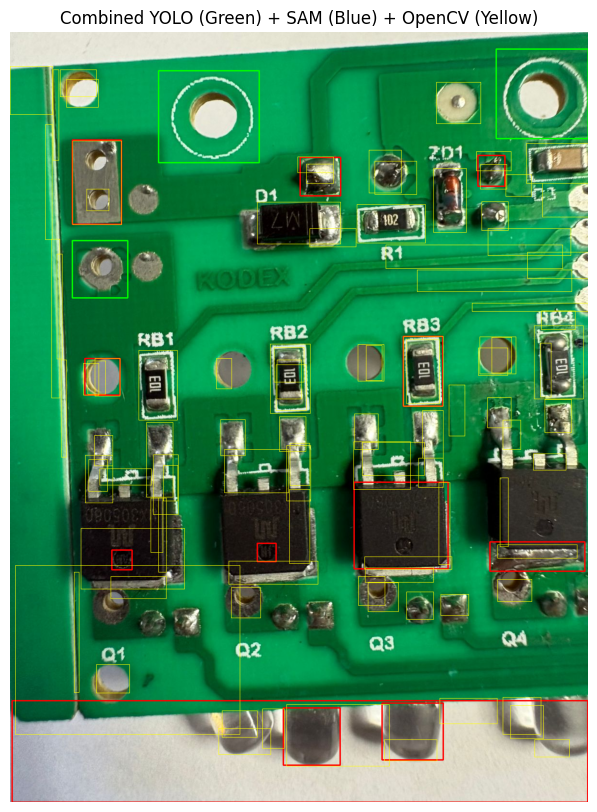

💾 Saved combined detection image at: /content/pcb_output/final_combined_detections.png
✂️ Cropping detected regions...
✅ Cropped 115 component regions.
📁 Crops saved to: /content/pcb_output/crops


In [20]:
# ==============================================================
# 🧠 PCB COMPONENT DETECTION — YOLO + SAM + OpenCV + Cropping
# ==============================================================
!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything gdown

# ==============================================================
# 🧩 Imports
# ==============================================================
import os, cv2, numpy as np, matplotlib.pyplot as plt
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
from google.colab import files, drive

# ==============================================================
# ⚙️ Setup
# ==============================================================
OUT_DIR = "/content/pcb_output"
CROP_DIR = f"{OUT_DIR}/crops"
os.makedirs(CROP_DIR, exist_ok=True)

# Mount Drive (optional — for saving outputs)
drive.mount('/content/drive', force_remount=True)
print("✅ Google Drive mounted successfully!")

# ==============================================================
# 🔍 Load YOLO Model (safe & automatic)
# ==============================================================
import gdown

MODEL_PATH = "/content/best.pt"
MODEL_ID = "194ZizH82qzep_Oefe352CvjC8Ml55Ljd"  # from your shared Drive folder

if not os.path.exists(MODEL_PATH):
    print("📥 best.pt not found locally. Downloading from Google Drive...")
    gdown.download(id=MODEL_ID, output=MODEL_PATH, quiet=False)
else:
    print(f"✅ Using existing YOLO model: {MODEL_PATH}")

# Load YOLO model
try:
    model = YOLO(MODEL_PATH)
    print("✅ YOLO model loaded successfully!")
except Exception as e:
    raise RuntimeError(f"❌ Failed to load YOLO model: {e}")

# ==============================================================
# 📤 Upload a single PCB image
# ==============================================================
print("📸 Please upload a PCB image:")
uploaded = files.upload()
image_path = list(uploaded.keys())[0]
image = cv2.imread(image_path)
if image is None:
    raise ValueError("❌ Image failed to load.")
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
print(f"✅ Image uploaded: {image_path}")

# ==============================================================
# 🟩 STEP 1 — YOLO Detection
# ==============================================================
print("🟩 Running YOLO detection...")
yolo_results = model.predict(source=image_rgb, conf=0.6, verbose=False)
yolo_boxes = []

for result in yolo_results:
    for box in result.boxes:
        x1, y1, x2, y2 = map(int, box.xyxy[0].cpu().numpy())
        conf = float(box.conf)
        cls = int(box.cls)
        label = result.names[cls]
        if conf > 0.6:
            yolo_boxes.append((x1, y1, x2, y2, label, conf))

yolo_image = image_rgb.copy()
for (x1, y1, x2, y2, label, conf) in yolo_boxes:
    cv2.rectangle(yolo_image, (x1, y1), (x2, y2), (0, 255, 0), 2)
    cv2.putText(yolo_image, f"{label}", (x1, y1 - 5),
                cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

print(f"✅ YOLO detected {len(yolo_boxes)} components.")

# ==============================================================
# 🧠 STEP 2 — SAM Segmentation (for uncovered areas)
# ==============================================================
print("🔵 Loading SAM model...")
if not os.path.exists("/content/sam_vit_b_01ec64.pth"):
    !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O /content/sam_vit_b_01ec64.pth

sam = sam_model_registry["vit_b"](checkpoint="/content/sam_vit_b_01ec64.pth")
mask_generator = SamAutomaticMaskGenerator(
    sam,
    points_per_side=8,               # smaller = faster
    pred_iou_thresh=0.9,
    stability_score_thresh=0.95,
    crop_n_layers=0,
    min_mask_region_area=1000
)
print("✅ SAM model ready!")

# Create mask for YOLO-covered areas
mask_yolo = np.zeros(image.shape[:2], dtype=np.uint8)
for (x1, y1, x2, y2, _, _) in yolo_boxes:
    cv2.rectangle(mask_yolo, (x1, y1), (x2, y2), 255, -1)

# Run SAM only on uncovered regions
inverse_mask = cv2.bitwise_not(mask_yolo)
uncovered = cv2.bitwise_and(image_rgb, image_rgb, mask=inverse_mask)

print("🔵 Running SAM on uncovered regions...")
masks = mask_generator.generate(uncovered)
sam_image = image_rgb.copy()
sam_boxes = []

for m in masks:
    seg = m["segmentation"].astype('uint8')
    x, y, w, h = cv2.boundingRect(seg)
    overlap = np.any(mask_yolo[y:y+h, x:x+w] > 0)
    if not overlap and w*h > 1000:
        cv2.rectangle(sam_image, (x, y), (x+w, y+h), (255, 0, 0), 2)
        sam_boxes.append((x, y, x+w, y+h))

print(f"✅ SAM added {len(sam_boxes)} new boxes.")

# ==============================================================
# 🟠 STEP 3 — OpenCV Edge-based Backup Detection
# ==============================================================
print("🟠 Running OpenCV edge detection as backup...")
gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
edges = cv2.Canny(gray, 60, 150)
contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
opencv_boxes = []

for c in contours:
    x, y, w, h = cv2.boundingRect(c)
    overlap = np.any(mask_yolo[y:y+h, x:x+w] > 0)
    if w*h > 2000 and not overlap:
        cv2.rectangle(image_rgb, (x, y), (x+w, y+h), (255, 255, 0), 1)
        opencv_boxes.append((x, y, x+w, y+h))

print(f"✅ OpenCV added {len(opencv_boxes)} boxes.")

# ==============================================================
# 🖼️ STEP 4 — Combine and Visualize All Boxes
# ==============================================================
final = image_rgb.copy()

# YOLO boxes (green)
for (x1, y1, x2, y2, _, _) in yolo_boxes:
    cv2.rectangle(final, (x1, y1), (x2, y2), (0, 255, 0), 2)
# SAM boxes (blue)
for (x1, y1, x2, y2) in sam_boxes:
    cv2.rectangle(final, (x1, y1), (x2, y2), (255, 0, 0), 2)
# OpenCV boxes (yellow)
for (x1, y1, x2, y2) in opencv_boxes:
    cv2.rectangle(final, (x1, y1), (x2, y2), (255, 255, 0), 1)

plt.figure(figsize=(10, 10))
plt.imshow(final)
plt.title("Combined YOLO (Green) + SAM (Blue) + OpenCV (Yellow)")
plt.axis('off')
plt.show()

cv2.imwrite(f"{OUT_DIR}/final_combined_detections.png", cv2.cvtColor(final, cv2.COLOR_RGB2BGR))
print(f"💾 Saved combined detection image at: {OUT_DIR}/final_combined_detections.png")

# ==============================================================
# ✂️ STEP 5 — Auto-Cropping Detected Components
# ==============================================================
print("✂️ Cropping detected regions...")
all_boxes = yolo_boxes + [(x1, y1, x2, y2, "sam", 1) for (x1, y1, x2, y2) in sam_boxes] + [(x1, y1, x2, y2, "opencv", 1) for (x1, y1, x2, y2) in opencv_boxes]
for i, (x1, y1, x2, y2, src, _) in enumerate(all_boxes):
    crop = image[y1:y2, x1:x2]
    if crop.size == 0: continue
    cv2.imwrite(f"{CROP_DIR}/{src}_crop_{i}.png", crop)

print(f"✅ Cropped {len(all_boxes)} component regions.")
print(f"📁 Crops saved to: {CROP_DIR}")


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 17.1 MB/s eta 0:00:00
Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
Mounted at /content/drive
✅ YOLO model: yolov8n.pt
📥 Downloading SAM (ViT-B)...
✅ SAM loaded on cuda
📸 Upload MASTER and TEST PCB images:


Saving tesssttt.jpeg to tesssttt.jpeg
Saving Masterrrrrr.jpeg to Masterrrrrr.jpeg
🔹 Detecting MASTER components...
🔹 Detecting TEST components...


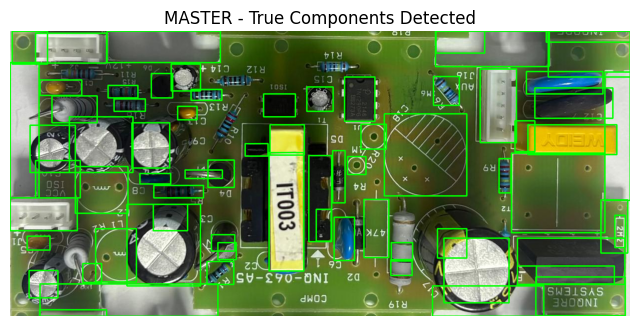

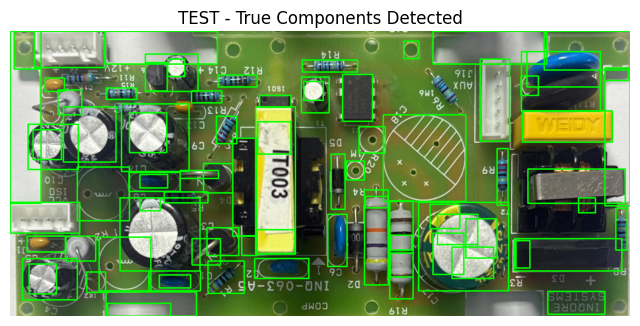

/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128308 (\N{LARGE RED CIRCLE}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


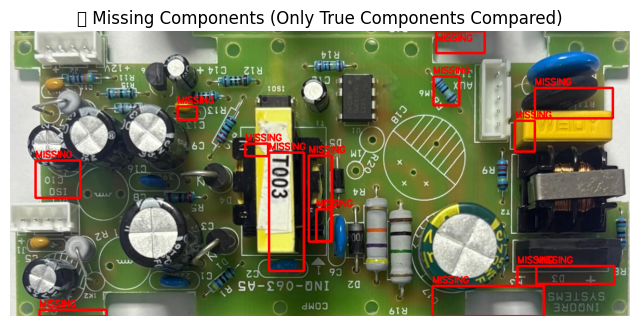

Master: 71 | Test: 84 | Missing: 14


In [1]:
# ==============================================================
# 🧠 SAM (ViT-B) + YOLOv8 + OpenCV — TRUE COMPONENT DETECTION
# ✅ Ignores random shapes, pads, or non-components
# ✅ Detects only real parts & marks only truly missing ones
# ==============================================================

!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

import os, cv2, json, numpy as np, matplotlib.pyplot as plt, torch
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
from google.colab import files, drive

# ==============================================================
# CONFIGURATION
# ==============================================================
OUT_DIR = "/content/pcb_output_clean"
os.makedirs(OUT_DIR, exist_ok=True)

YOLO_CONF = 0.6
MIN_BOX_AREA = 1000       # ignore small artifacts
MAX_BOX_AREA = 50000      # ignore huge masks or board zones
IOU_THRESH = 0.45
MERGE_IOU = 0.4
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

# ==============================================================
# LOAD MODELS
# ==============================================================
drive.mount('/content/drive', force_remount=True)

search_root = "/content/drive/My Drive/YOLO"
MODEL_PATH = None
for root, _, files_in_dir in os.walk(search_root):
    for f in files_in_dir:
        if f == "best.pt":
            MODEL_PATH = os.path.join(root, f)
            break
    if MODEL_PATH:
        break
if MODEL_PATH is None:
    MODEL_PATH = "yolov8n.pt"
print("✅ YOLO model:", MODEL_PATH)
yolo = YOLO(MODEL_PATH)

sam_ckpt = "/content/sam_vit_b_01ec64.pth"
if not os.path.exists(sam_ckpt) or os.path.getsize(sam_ckpt) < 350_000_000:
    print("📥 Downloading SAM (ViT-B)...")
    !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {sam_ckpt}

sam = sam_model_registry["vit_b"](checkpoint=sam_ckpt)
sam.to(device=DEVICE)
mask_generator = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=32,
    pred_iou_thresh=0.90,
    stability_score_thresh=0.95,
    crop_n_layers=1,
    min_mask_region_area=1500
)
print("✅ SAM loaded on", DEVICE)

# ==============================================================
# HELPERS
# ==============================================================
def iou(boxA, boxB):
    xA, yA = max(boxA[0], boxB[0]), max(boxA[1], boxB[1])
    xB, yB = min(boxA[2], boxB[2]), min(boxA[3], boxB[3])
    inter = max(0, xB-xA) * max(0, yB-yA)
    areaA = (boxA[2]-boxA[0])*(boxA[3]-boxA[1])
    areaB = (boxB[2]-boxB[0])*(boxB[3]-boxB[1])
    return inter / (areaA + areaB - inter + 1e-9)

def merge_boxes(boxes, iou_threshold=MERGE_IOU):
    merged = []
    for b in boxes:
        merged_flag = False
        for i, mb in enumerate(merged):
            if iou(b, mb) > iou_threshold:
                x1, y1, x2, y2 = min(b[0],mb[0]), min(b[1],mb[1]), max(b[2],mb[2]), max(b[3],mb[3])
                merged[i] = (x1,y1,x2,y2)
                merged_flag = True
                break
        if not merged_flag:
            merged.append(b)
    return merged

def box_center(box):
    x1, y1, x2, y2 = box
    return ((x1+x2)/2, (y1+y2)/2)

def are_similar(boxA, boxB, iou_thresh=IOU_THRESH, center_thresh=40):
    if iou(boxA, boxB) >= iou_thresh:
        return True
    cA, cB = box_center(boxA), box_center(boxB)
    return np.linalg.norm(np.array(cA)-np.array(cB)) < center_thresh

def is_valid_component(roi):
    """Reject regions that don't look like components"""
    if roi.size == 0:
        return False
    gray = cv2.cvtColor(roi, cv2.COLOR_BGR2GRAY)
    var = np.var(gray)
    mean = np.mean(gray)
    edges = cv2.Canny(gray, 50, 150)
    edge_density = np.sum(edges > 0) / (gray.shape[0]*gray.shape[1])

    # Reject smooth/bright regions (pads/text/holes)
    if var < 100:  # texture too uniform
        return False
    if mean > 220:  # too bright (bare copper or white text)
        return False
    if edge_density < 0.02:  # not enough structure
        return False
    return True

# ==============================================================
# AUTO-CROP
# ==============================================================
def auto_crop_board_color_based(image):
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    lower_green, upper_green = np.array([25,30,30]), np.array([100,255,255])
    mask = cv2.inRange(hsv, lower_green, upper_green)
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (7,7))
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=2)
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours:
        return image
    x, y, w, h = cv2.boundingRect(max(contours, key=cv2.contourArea))
    return image[y:y+h, x:x+w]

# ==============================================================
# DETECTION FUNCTION
# ==============================================================
def detect_components(image_bgr):
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
    results = yolo.predict(source=image_rgb, conf=YOLO_CONF, device=DEVICE, verbose=False)
    boxes = []
    if len(results)>0 and len(results[0].boxes)>0:
        for b in results[0].boxes.xyxy.cpu().numpy():
            x1,y1,x2,y2 = map(int,b)
            if (x2-x1)*(y2-y1) > MIN_BOX_AREA:
                boxes.append((x1,y1,x2,y2))

    # SAM detections
    try:
        masks = mask_generator.generate(image_rgb)
        for m in masks:
            seg = m["segmentation"].astype('uint8')
            x,y,w,h = cv2.boundingRect(seg)
            area = w*h
            if MIN_BOX_AREA < area < MAX_BOX_AREA:
                roi = image_bgr[y:y+h, x:x+w]
                if is_valid_component(roi):
                    boxes.append((x,y,x+w,y+h))
    except Exception as e:
        print("SAM error:", e)

    # Merge overlapping
    boxes = merge_boxes(boxes)

    # Filter again for visual validity
    valid_boxes = []
    for (x1,y1,x2,y2) in boxes:
        roi = image_bgr[y1:y2, x1:x2]
        if is_valid_component(roi):
            valid_boxes.append((x1,y1,x2,y2))

    # Visualize
    vis = image_rgb.copy()
    for (x1,y1,x2,y2) in valid_boxes:
        cv2.rectangle(vis, (x1,y1), (x2,y2), (0,255,0), 2)
    return valid_boxes, vis

# ==============================================================
# UPLOAD IMAGES
# ==============================================================
print("📸 Upload MASTER and TEST PCB images:")
uploaded = files.upload()
keys = list(uploaded.keys())
if len(keys) < 2:
    raise ValueError("Please upload both images.")
master_img = cv2.imdecode(np.frombuffer(uploaded[keys[0]], np.uint8), cv2.IMREAD_COLOR)
test_img   = cv2.imdecode(np.frombuffer(uploaded[keys[1]], np.uint8), cv2.IMREAD_COLOR)

# Crop and align
master_crop = auto_crop_board_color_based(master_img)
mh, mw = master_crop.shape[:2]
test_crop = cv2.resize(auto_crop_board_color_based(test_img), (mw, mh))

# ==============================================================
# DETECT COMPONENTS
# ==============================================================
print("🔹 Detecting MASTER components...")
master_boxes, master_vis = detect_components(master_crop)
print("🔹 Detecting TEST components...")
test_boxes, test_vis = detect_components(test_crop)

# ==============================================================
# DISPLAY MASTER/TEST
# ==============================================================
plt.figure(figsize=(8,8))
plt.imshow(master_vis)
plt.title("MASTER - True Components Detected")
plt.axis("off")
plt.show()

plt.figure(figsize=(8,8))
plt.imshow(test_vis)
plt.title("TEST - True Components Detected")
plt.axis("off")
plt.show()

# ==============================================================
# COMPARE — FIND MISSING COMPONENTS
# ==============================================================
missing = []
for mb in master_boxes:
    if not any(are_similar(mb, tb) for tb in test_boxes):
        missing.append(mb)
missing = merge_boxes(missing)

# ==============================================================
# SHOW MISSING ONLY ON TEST IMAGE
# ==============================================================
final_vis = cv2.cvtColor(test_crop.copy(), cv2.COLOR_BGR2RGB)
for (x1, y1, x2, y2) in missing:
    cv2.rectangle(final_vis, (x1, y1), (x2, y2), (255, 0, 0), 3)
    cv2.putText(final_vis, "MISSING", (x1, max(20, y1-6)), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

if not missing:
    cv2.putText(final_vis, "✅ GOOD BOARD - No Missing Components",
                (30, 50), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 200, 0), 3)

plt.figure(figsize=(8,8))
plt.imshow(final_vis)
plt.title("🔴 Missing Components (Only True Components Compared)")
plt.axis("off")
plt.show()

print(f"Master: {len(master_boxes)} | Test: {len(test_boxes)} | Missing: {len(missing)}")


📥 Downloading YOLO model...
/usr/local/lib/python3.12/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=194ZizH82qzep_Oefe352CvjC8Ml55Ljd
To: /content/best.pt
100% 19.2M/19.2M [00:00<00:00, 36.5MB/s]
✅ YOLO model loaded: /content/best.pt
✅ SAM loaded successfully on cuda
📸 Upload MASTER and TEST PCB images:


Saving tesssttt.jpeg to tesssttt (1).jpeg
Saving Masterrrrrr.jpeg to Masterrrrrr (1).jpeg
🔹 Detecting MASTER components...
🔹 Detecting TEST components...
💾 JSON results saved to: /content/pcb_output_final/pcb_comparison_results.json


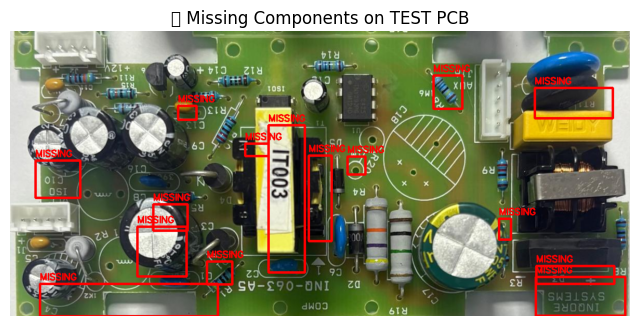

Master: 60 | Test: 72 | Missing: 15


In [2]:
# ==============================================================
# 🧠 SAM (ViT-B) + YOLOv8 + OpenCV — TRUE COMPONENT DETECTION (Enhanced)
# ✅ Marks missing components ONLY on TEST image
# ✅ Exports JSON data for Master, Test, and Missing components
# ==============================================================

!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

import os, cv2, json, numpy as np, matplotlib.pyplot as plt, torch
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
from google.colab import files

# ==============================================================
# CONFIGURATION
# ==============================================================
OUT_DIR = "/content/pcb_output_final"
os.makedirs(OUT_DIR, exist_ok=True)

YOLO_CONF = 0.6
MIN_BOX_AREA = 1000
MAX_BOX_AREA = 50000
IOU_THRESH = 0.45
MERGE_IOU = 0.4
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

# ==============================================================
# LOAD MODELS
# ==============================================================
MODEL_PATH = "/content/best.pt"  # <-- Change if needed
if not os.path.exists(MODEL_PATH):
    print("📥 Downloading YOLO model...")
    !pip install -q gdown
    !gdown --id 194ZizH82qzep_Oefe352CvjC8Ml55Ljd -O /content/best.pt

yolo = YOLO(MODEL_PATH)
print(f"✅ YOLO model loaded: {MODEL_PATH}")

# SAM model
sam_ckpt = "/content/sam_vit_b_01ec64.pth"
if not os.path.exists(sam_ckpt):
    print("📥 Downloading SAM (ViT-B)...")
    !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {sam_ckpt}

sam = sam_model_registry["vit_b"](checkpoint=sam_ckpt)
sam.to(device=DEVICE)
mask_generator = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=16,
    pred_iou_thresh=0.90,
    stability_score_thresh=0.95,
    crop_n_layers=1,
    min_mask_region_area=1500
)
print("✅ SAM loaded successfully on", DEVICE)

# ==============================================================
# HELPER FUNCTIONS
# ==============================================================
def iou(boxA, boxB):
    xA, yA = max(boxA[0], boxB[0]), max(boxA[1], boxB[1])
    xB, yB = min(boxA[2], boxB[2]), min(boxA[3], boxB[3])
    inter = max(0, xB - xA) * max(0, yB - yA)
    areaA = (boxA[2]-boxA[0])*(boxA[3]-boxA[1])
    areaB = (boxB[2]-boxB[0])*(boxB[3]-boxB[1])
    return inter / (areaA + areaB - inter + 1e-9)

def merge_boxes(boxes, iou_threshold=MERGE_IOU):
    merged = []
    for b in boxes:
        merged_flag = False
        for i, mb in enumerate(merged):
            if iou(b, mb) > iou_threshold:
                x1, y1, x2, y2 = min(b[0],mb[0]), min(b[1],mb[1]), max(b[2],mb[2]), max(b[3],mb[3])
                merged[i] = (x1,y1,x2,y2)
                merged_flag = True
                break
        if not merged_flag:
            merged.append(b)
    return merged

def box_center(box):
    x1, y1, x2, y2 = box
    return ((x1+x2)/2, (y1+y2)/2)

def are_similar(boxA, boxB, iou_thresh=IOU_THRESH, center_thresh=40):
    if iou(boxA, boxB) >= iou_thresh:
        return True
    cA, cB = box_center(boxA), box_center(boxB)
    return np.linalg.norm(np.array(cA)-np.array(cB)) < center_thresh

def is_valid_component(roi):
    if roi.size == 0:
        return False
    gray = cv2.cvtColor(roi, cv2.COLOR_BGR2GRAY)
    var = np.var(gray)
    mean = np.mean(gray)
    edges = cv2.Canny(gray, 50, 150)
    edge_density = np.sum(edges > 0) / (gray.shape[0]*gray.shape[1])
    if var < 100 or mean > 220 or edge_density < 0.02:
        return False
    return True

def auto_crop_board_color_based(image):
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    lower_green, upper_green = np.array([25,30,30]), np.array([100,255,255])
    mask = cv2.inRange(hsv, lower_green, upper_green)
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (7,7))
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=2)
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours:
        return image
    x, y, w, h = cv2.boundingRect(max(contours, key=cv2.contourArea))
    return image[y:y+h, x:x+w]

# ==============================================================
# DETECTION FUNCTION
# ==============================================================
def detect_components(image_bgr):
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
    results = yolo.predict(source=image_rgb, conf=YOLO_CONF, device=DEVICE, verbose=False)
    boxes = []
    if len(results)>0 and len(results[0].boxes)>0:
        for b in results[0].boxes.xyxy.cpu().numpy():
            x1, y1, x2, y2 = map(int,b)
            if (x2-x1)*(y2-y1) > MIN_BOX_AREA:
                boxes.append((x1,y1,x2,y2))

    # SAM refinement
    try:
        masks = mask_generator.generate(image_rgb)
        for m in masks:
            seg = m["segmentation"].astype('uint8')
            x,y,w,h = cv2.boundingRect(seg)
            area = w*h
            if MIN_BOX_AREA < area < MAX_BOX_AREA:
                roi = image_bgr[y:y+h, x:x+w]
                if is_valid_component(roi):
                    boxes.append((x,y,x+w,y+h))
    except Exception as e:
        print("SAM error:", e)

    boxes = merge_boxes(boxes)
    valid_boxes = []
    for (x1,y1,x2,y2) in boxes:
        roi = image_bgr[y1:y2, x1:x2]
        if is_valid_component(roi):
            valid_boxes.append((x1,y1,x2,y2))
    return valid_boxes

# ==============================================================
# UPLOAD IMAGES
# ==============================================================
print("📸 Upload MASTER and TEST PCB images:")
uploaded = files.upload()
keys = list(uploaded.keys())
if len(keys) < 2:
    raise ValueError("Please upload both images.")
master_img = cv2.imdecode(np.frombuffer(uploaded[keys[0]], np.uint8), cv2.IMREAD_COLOR)
test_img   = cv2.imdecode(np.frombuffer(uploaded[keys[1]], np.uint8), cv2.IMREAD_COLOR)

# Crop & align
master_crop = auto_crop_board_color_based(master_img)
mh, mw = master_crop.shape[:2]
test_crop = cv2.resize(auto_crop_board_color_based(test_img), (mw, mh))

# ==============================================================
# DETECT COMPONENTS
# ==============================================================
print("🔹 Detecting MASTER components...")
master_boxes = detect_components(master_crop)
print("🔹 Detecting TEST components...")
test_boxes = detect_components(test_crop)

# ==============================================================
# FIND MISSING COMPONENTS (on TEST)
# ==============================================================
missing = []
for mb in master_boxes:
    if not any(are_similar(mb, tb) for tb in test_boxes):
        missing.append(mb)
missing = merge_boxes(missing)

# ==============================================================
# JSON OUTPUT
# ==============================================================
json_data = {
    "master_components": [
        {"x1": x1, "y1": y1, "x2": x2, "y2": y2} for (x1,y1,x2,y2) in master_boxes
    ],
    "test_components": [
        {"x1": x1, "y1": y1, "x2": x2, "y2": y2} for (x1,y1,x2,y2) in test_boxes
    ],
    "missing_components": [
        {"x1": x1, "y1": y1, "x2": x2, "y2": y2} for (x1,y1,x2,y2) in missing
    ]
}

json_path = os.path.join(OUT_DIR, "pcb_comparison_results.json")
with open(json_path, "w") as f:
    json.dump(json_data, f, indent=4)
print(f"💾 JSON results saved to: {json_path}")

# ==============================================================
# VISUALIZE ONLY MISSING ON TEST IMAGE
# ==============================================================
final_vis = cv2.cvtColor(test_crop.copy(), cv2.COLOR_BGR2RGB)
for (x1, y1, x2, y2) in missing:
    cv2.rectangle(final_vis, (x1, y1), (x2, y2), (255, 0, 0), 3)
    cv2.putText(final_vis, "MISSING", (x1, max(25, y1-8)),
                cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

if not missing:
    cv2.putText(final_vis, "✅ GOOD BOARD - No Missing Components",
                (30, 50), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 200, 0), 3)

plt.figure(figsize=(8,8))
plt.imshow(final_vis)
plt.title("🔴 Missing Components on TEST PCB")
plt.axis("off")
plt.show()

print(f"Master: {len(master_boxes)} | Test: {len(test_boxes)} | Missing: {len(missing)}")


✅ YOLO model loaded: /content/best.pt
✅ SAM ready on cuda
📸 Upload MASTER and TEST PCB images:


Saving tesssttt.jpeg to tesssttt (2).jpeg
Saving Masterrrrrr.jpeg to Masterrrrrr (2).jpeg
🔹 Detecting MASTER...
✅ YOLO found 5 components
✅ SAM added 74 total after refinement
✅ OpenCV total components after shape check: 159
🔹 Detecting TEST...
✅ YOLO found 4 components
✅ SAM added 84 total after refinement
✅ OpenCV total components after shape check: 172
💾 JSON saved to: /content/pcb_output_strict/pcb_comparison_results.json


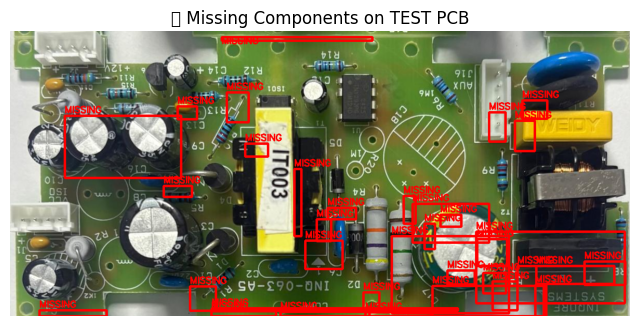

Master: 120 | Test: 121 | Missing: 35
📁 Output image saved at: /content/pcb_output_strict/test_missing_marked.png


In [3]:
# ==============================================================
# 🧠 TRUE COMPONENT DETECTION PIPELINE
# ✅ YOLOv8 → SAM → OpenCV
# ✅ Only real components marked
# ✅ Missing marked only on TEST
# ✅ JSON output included
# ==============================================================

!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

import os, cv2, json, numpy as np, matplotlib.pyplot as plt, torch
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
from google.colab import files

# ==============================================================
# CONFIG
# ==============================================================
OUT_DIR = "/content/pcb_output_strict"
os.makedirs(OUT_DIR, exist_ok=True)

YOLO_CONF = 0.6
MIN_BOX_AREA = 1000
MAX_BOX_AREA = 60000
IOU_THRESH = 0.45
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

# ==============================================================
# LOAD MODELS
# ==============================================================
MODEL_PATH = "/content/best.pt"
if not os.path.exists(MODEL_PATH):
    print("📥 Downloading YOLO model...")
    !pip install -q gdown
    !gdown --id 194ZizH82qzep_Oefe352CvjC8Ml55Ljd -O /content/best.pt

yolo = YOLO(MODEL_PATH)
print("✅ YOLO model loaded:", MODEL_PATH)

sam_ckpt = "/content/sam_vit_b_01ec64.pth"
if not os.path.exists(sam_ckpt):
    print("📥 Downloading SAM model...")
    !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {sam_ckpt}

sam = sam_model_registry["vit_b"](checkpoint=sam_ckpt)
sam.to(device=DEVICE)
mask_generator = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=32,
    pred_iou_thresh=0.9,
    stability_score_thresh=0.95,
    crop_n_layers=1,
    min_mask_region_area=1500
)
print("✅ SAM ready on", DEVICE)

# ==============================================================
# HELPERS
# ==============================================================
def iou(boxA, boxB):
    xA, yA = max(boxA[0], boxB[0]), max(boxA[1], boxB[1])
    xB, yB = min(boxA[2], boxB[2]), min(boxA[3], boxB[3])
    inter = max(0, xB-xA) * max(0, yB-yA)
    areaA = (boxA[2]-boxA[0])*(boxA[3]-boxA[1])
    areaB = (boxB[2]-boxB[0])*(boxB[3]-boxB[1])
    return inter / (areaA + areaB - inter + 1e-9)

def box_center(box):
    x1,y1,x2,y2 = box
    return ((x1+x2)/2, (y1+y2)/2)

def are_similar(boxA, boxB, iou_thresh=IOU_THRESH, center_thresh=40):
    if iou(boxA, boxB) >= iou_thresh:
        return True
    cA, cB = box_center(boxA), box_center(boxB)
    return np.linalg.norm(np.array(cA)-np.array(cB)) < center_thresh

def is_valid_component(roi):
    """Reject smooth, bright, or textureless regions."""
    if roi.size == 0: return False
    gray = cv2.cvtColor(roi, cv2.COLOR_BGR2GRAY)
    var = np.var(gray)
    mean = np.mean(gray)
    edges = cv2.Canny(gray, 40, 150)
    edge_density = np.sum(edges > 0) / (gray.shape[0]*gray.shape[1])
    return not (var < 100 or mean > 220 or edge_density < 0.02)

def merge_boxes(boxes, iou_threshold=0.4):
    merged = []
    for b in boxes:
        merged_flag = False
        for i, mb in enumerate(merged):
            if iou(b, mb) > iou_threshold:
                x1,y1,x2,y2 = min(b[0],mb[0]), min(b[1],mb[1]), max(b[2],mb[2]), max(b[3],mb[3])
                merged[i] = (x1,y1,x2,y2)
                merged_flag = True
                break
        if not merged_flag:
            merged.append(b)
    return merged

def auto_crop_board(image):
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    lower_green, upper_green = np.array([25,30,30]), np.array([100,255,255])
    mask = cv2.inRange(hsv, lower_green, upper_green)
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (7,7))
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=2)
    contours,_ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours: return image
    x,y,w,h = cv2.boundingRect(max(contours,key=cv2.contourArea))
    return image[y:y+h, x:x+w]

# ==============================================================
# COMPONENT DETECTION PIPELINE (YOLO → SAM → OpenCV)
# ==============================================================
def detect_components(image_bgr):
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
    detected_boxes = []

    # ---- STEP 1: YOLO Detection ----
    results = yolo.predict(source=image_rgb, conf=YOLO_CONF, device=DEVICE, verbose=False)
    if len(results)>0 and len(results[0].boxes)>0:
        for b in results[0].boxes.xyxy.cpu().numpy():
            x1,y1,x2,y2 = map(int,b)
            if (x2-x1)*(y2-y1) > MIN_BOX_AREA:
                detected_boxes.append((x1,y1,x2,y2))
    print(f"✅ YOLO found {len(detected_boxes)} components")

    # Mask for YOLO-detected areas
    mask_yolo = np.zeros(image_bgr.shape[:2], dtype=np.uint8)
    for (x1,y1,x2,y2) in detected_boxes:
        cv2.rectangle(mask_yolo, (x1,y1), (x2,y2), 255, -1)

    # ---- STEP 2: SAM fallback (only in uncovered areas) ----
    inverse_mask = cv2.bitwise_not(mask_yolo)
    uncovered = cv2.bitwise_and(image_rgb, image_rgb, mask=inverse_mask)
    try:
        masks = mask_generator.generate(uncovered)
        for m in masks:
            seg = m["segmentation"].astype('uint8')
            x,y,w,h = cv2.boundingRect(seg)
            if MIN_BOX_AREA < w*h < MAX_BOX_AREA:
                roi = image_bgr[y:y+h, x:x+w]
                if is_valid_component(roi):
                    detected_boxes.append((x,y,x+w,y+h))
    except Exception as e:
        print("SAM error:", e)
    print(f"✅ SAM added {len(detected_boxes)} total after refinement")

    # ---- STEP 3: OpenCV fallback (only structured shapes) ----
    gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)
    edges = cv2.Canny(gray, 60, 150)
    contours,_ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    for c in contours:
        x,y,w,h = cv2.boundingRect(c)
        area = w*h
        overlap = np.any(mask_yolo[y:y+h,x:x+w] > 0)
        if MIN_BOX_AREA < area < MAX_BOX_AREA and not overlap:
            roi = image_bgr[y:y+h, x:x+w]
            if is_valid_component(roi):
                detected_boxes.append((x,y,x+w,y+h))
    print(f"✅ OpenCV total components after shape check: {len(detected_boxes)}")

    # ---- Final merge & cleanup ----
    detected_boxes = merge_boxes(detected_boxes)
    return detected_boxes

# ==============================================================
# UPLOAD MASTER AND TEST IMAGES
# ==============================================================
print("📸 Upload MASTER and TEST PCB images:")
uploaded = files.upload()
keys = list(uploaded.keys())
if len(keys) < 2:
    raise ValueError("Please upload both images.")
master_img = cv2.imdecode(np.frombuffer(uploaded[keys[0]], np.uint8), cv2.IMREAD_COLOR)
test_img = cv2.imdecode(np.frombuffer(uploaded[keys[1]], np.uint8), cv2.IMREAD_COLOR)

# Crop & align
master_crop = auto_crop_board(master_img)
mh, mw = master_crop.shape[:2]
test_crop = cv2.resize(auto_crop_board(test_img), (mw, mh))

# ==============================================================
# DETECTION + COMPARISON
# ==============================================================
print("🔹 Detecting MASTER...")
master_boxes = detect_components(master_crop)
print("🔹 Detecting TEST...")
test_boxes = detect_components(test_crop)

# Missing
missing = []
for mb in master_boxes:
    if not any(are_similar(mb, tb) for tb in test_boxes):
        missing.append(mb)
missing = merge_boxes(missing)

# ==============================================================
# SAVE JSON RESULTS
# ==============================================================
json_data = {
    "master_components": [{"x1":x1,"y1":y1,"x2":x2,"y2":y2} for (x1,y1,x2,y2) in master_boxes],
    "test_components": [{"x1":x1,"y1":y1,"x2":x2,"y2":y2} for (x1,y1,x2,y2) in test_boxes],
    "missing_components": [{"x1":x1,"y1":y1,"x2":x2,"y2":y2} for (x1,y1,x2,y2) in missing]
}
json_path = os.path.join(OUT_DIR, "pcb_comparison_results.json")
with open(json_path, "w") as f:
    json.dump(json_data, f, indent=4)
print(f"💾 JSON saved to: {json_path}")

# ==============================================================
# VISUALIZE ONLY MISSING ON TEST
# ==============================================================
final_vis = cv2.cvtColor(test_crop.copy(), cv2.COLOR_BGR2RGB)
for (x1,y1,x2,y2) in missing:
    cv2.rectangle(final_vis, (x1,y1), (x2,y2), (255,0,0), 3)
    cv2.putText(final_vis, "MISSING", (x1, max(25, y1-6)),
                cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255,0,0), 2)

if not missing:
    cv2.putText(final_vis, "✅ GOOD BOARD - No Missing Components",
                (30,50), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0,200,0), 3)

save_path = os.path.join(OUT_DIR, "test_missing_marked.png")
cv2.imwrite(save_path, cv2.cvtColor(final_vis, cv2.COLOR_RGB2BGR))

plt.figure(figsize=(8,8))
plt.imshow(final_vis)
plt.title("🔴 Missing Components on TEST PCB")
plt.axis("off")
plt.show()

print(f"Master: {len(master_boxes)} | Test: {len(test_boxes)} | Missing: {len(missing)}")
print(f"📁 Output image saved at: {save_path}")


✅ YOLO model loaded: /content/best.pt
✅ SAM loaded on cuda
📸 Upload MASTER and TEST PCB images:


Saving tesssttt.jpeg to tesssttt (3).jpeg
Saving Masterrrrrr.jpeg to Masterrrrrr (3).jpeg
🔹 Detecting MASTER...
✅ YOLO found 5 components
✅ Total components after SAM refinement: 111
🔹 Detecting TEST...
✅ YOLO found 4 components
✅ Total components after SAM refinement: 111
💾 JSON saved to: /content/pcb_output_sam_aggressive/pcb_comparison_results.json


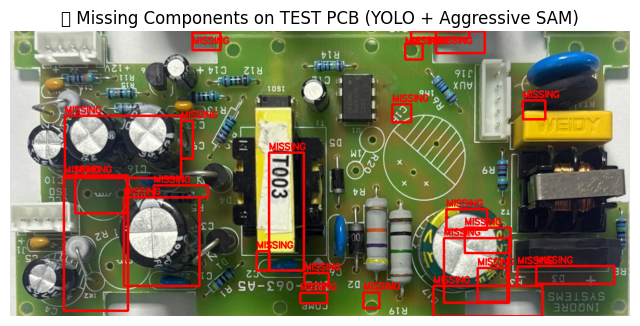

Master: 111 | Test: 111 | Missing: 24
📁 Output image saved at: /content/pcb_output_sam_aggressive/test_missing_marked.png


In [4]:
# ==============================================================
# 🧠 TRUE COMPONENT DETECTION — YOLOv8 + Aggressive SAM (ViT-B)
# ✅ YOLO primary detector
# ✅ SAM aggressive refinement (no OpenCV)
# ✅ Missing components marked ONLY on TEST
# ✅ JSON output for all components
# ==============================================================

!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

import os, cv2, json, numpy as np, matplotlib.pyplot as plt, torch
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
from google.colab import files

# ==============================================================
# CONFIG
# ==============================================================
OUT_DIR = "/content/pcb_output_sam_aggressive"
os.makedirs(OUT_DIR, exist_ok=True)

YOLO_CONF = 0.6
MIN_BOX_AREA = 1000
MAX_BOX_AREA = 60000
IOU_THRESH = 0.45
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

# ==============================================================
# LOAD MODELS
# ==============================================================
MODEL_PATH = "/content/best.pt"
if not os.path.exists(MODEL_PATH):
    print("📥 Downloading YOLO model...")
    !pip install -q gdown
    !gdown --id 194ZizH82qzep_Oefe352CvjC8Ml55Ljd -O /content/best.pt

yolo = YOLO(MODEL_PATH)
print("✅ YOLO model loaded:", MODEL_PATH)

sam_ckpt = "/content/sam_vit_b_01ec64.pth"
if not os.path.exists(sam_ckpt):
    print("📥 Downloading SAM model...")
    !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {sam_ckpt}

sam = sam_model_registry["vit_b"](checkpoint=sam_ckpt)
sam.to(device=DEVICE)
mask_generator = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=64,                 # aggressive: dense sampling
    pred_iou_thresh=0.85,               # lower threshold = more regions
    stability_score_thresh=0.9,
    crop_n_layers=1,
    min_mask_region_area=800
)
print("✅ SAM loaded on", DEVICE)

# ==============================================================
# HELPER FUNCTIONS
# ==============================================================
def iou(boxA, boxB):
    xA, yA = max(boxA[0], boxB[0]), max(boxA[1], boxB[1])
    xB, yB = min(boxA[2], boxB[2]), min(boxA[3], boxB[3])
    inter = max(0, xB-xA) * max(0, yB-yA)
    areaA = (boxA[2]-boxA[0])*(boxA[3]-boxA[1])
    areaB = (boxB[2]-boxB[0])*(boxB[3]-boxB[1])
    return inter / (areaA + areaB - inter + 1e-9)

def box_center(box):
    x1,y1,x2,y2 = box
    return ((x1+x2)/2, (y1+y2)/2)

def are_similar(boxA, boxB, iou_thresh=IOU_THRESH, center_thresh=40):
    if iou(boxA, boxB) >= iou_thresh:
        return True
    cA, cB = box_center(boxA), box_center(boxB)
    return np.linalg.norm(np.array(cA)-np.array(cB)) < center_thresh

def is_valid_component(roi):
    """Reject smooth, bright, or textureless regions."""
    if roi.size == 0: return False
    gray = cv2.cvtColor(roi, cv2.COLOR_BGR2GRAY)
    var = np.var(gray)
    mean = np.mean(gray)
    edges = cv2.Canny(gray, 40, 150)
    edge_density = np.sum(edges > 0) / (gray.shape[0]*gray.shape[1])
    return not (var < 80 or mean > 220 or edge_density < 0.02)

def merge_boxes(boxes, iou_threshold=0.4):
    merged = []
    for b in boxes:
        merged_flag = False
        for i, mb in enumerate(merged):
            if iou(b, mb) > iou_threshold:
                x1,y1,x2,y2 = min(b[0],mb[0]), min(b[1],mb[1]), max(b[2],mb[2]), max(b[3],mb[3])
                merged[i] = (x1,y1,x2,y2)
                merged_flag = True
                break
        if not merged_flag:
            merged.append(b)
    return merged

def auto_crop_board(image):
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    lower_green, upper_green = np.array([25,30,30]), np.array([100,255,255])
    mask = cv2.inRange(hsv, lower_green, upper_green)
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (7,7))
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=2)
    contours,_ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours: return image
    x,y,w,h = cv2.boundingRect(max(contours,key=cv2.contourArea))
    return image[y:y+h, x:x+w]

# ==============================================================
# COMPONENT DETECTION — YOLO + Aggressive SAM
# ==============================================================
def detect_components(image_bgr):
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
    detected_boxes = []

    # ---- STEP 1: YOLO Detection ----
    results = yolo.predict(source=image_rgb, conf=YOLO_CONF, device=DEVICE, verbose=False)
    if len(results)>0 and len(results[0].boxes)>0:
        for b in results[0].boxes.xyxy.cpu().numpy():
            x1,y1,x2,y2 = map(int,b)
            if (x2-x1)*(y2-y1) > MIN_BOX_AREA:
                detected_boxes.append((x1,y1,x2,y2))
    print(f"✅ YOLO found {len(detected_boxes)} components")

    # Create YOLO mask
    mask_yolo = np.zeros(image_bgr.shape[:2], dtype=np.uint8)
    for (x1,y1,x2,y2) in detected_boxes:
        cv2.rectangle(mask_yolo, (x1,y1), (x2,y2), 255, -1)

    # ---- STEP 2: Aggressive SAM on uncovered regions ----
    inverse_mask = cv2.bitwise_not(mask_yolo)
    uncovered = cv2.bitwise_and(image_rgb, image_rgb, mask=inverse_mask)

    try:
        masks = mask_generator.generate(uncovered)
        for m in masks:
            seg = m["segmentation"].astype('uint8')
            x,y,w,h = cv2.boundingRect(seg)
            area = w*h
            if MIN_BOX_AREA < area < MAX_BOX_AREA:
                roi = image_bgr[y:y+h, x:x+w]
                if is_valid_component(roi):
                    detected_boxes.append((x,y,x+w,y+h))
    except Exception as e:
        print("SAM error:", e)

    detected_boxes = merge_boxes(detected_boxes)
    print(f"✅ Total components after SAM refinement: {len(detected_boxes)}")
    return detected_boxes

# ==============================================================
# UPLOAD MASTER & TEST
# ==============================================================
print("📸 Upload MASTER and TEST PCB images:")
uploaded = files.upload()
keys = list(uploaded.keys())
if len(keys) < 2:
    raise ValueError("Please upload both images.")
master_img = cv2.imdecode(np.frombuffer(uploaded[keys[0]], np.uint8), cv2.IMREAD_COLOR)
test_img = cv2.imdecode(np.frombuffer(uploaded[keys[1]], np.uint8), cv2.IMREAD_COLOR)

# Crop & align
master_crop = auto_crop_board(master_img)
mh, mw = master_crop.shape[:2]
test_crop = cv2.resize(auto_crop_board(test_img), (mw, mh))

# ==============================================================
# DETECTION + COMPARISON
# ==============================================================
print("🔹 Detecting MASTER...")
master_boxes = detect_components(master_crop)
print("🔹 Detecting TEST...")
test_boxes = detect_components(test_crop)

# Identify missing components
missing = []
for mb in master_boxes:
    if not any(are_similar(mb, tb) for tb in test_boxes):
        missing.append(mb)
missing = merge_boxes(missing)

# ==============================================================
# SAVE JSON RESULTS
# ==============================================================
json_data = {
    "master_components": [{"x1":x1,"y1":y1,"x2":x2,"y2":y2} for (x1,y1,x2,y2) in master_boxes],
    "test_components": [{"x1":x1,"y1":y1,"x2":x2,"y2":y2} for (x1,y1,x2,y2) in test_boxes],
    "missing_components": [{"x1":x1,"y1":y1,"x2":x2,"y2":y2} for (x1,y1,x2,y2) in missing]
}
json_path = os.path.join(OUT_DIR, "pcb_comparison_results.json")
with open(json_path, "w") as f:
    json.dump(json_data, f, indent=4)
print(f"💾 JSON saved to: {json_path}")

# ==============================================================
# VISUALIZE MISSING ONLY ON TEST IMAGE
# ==============================================================
final_vis = cv2.cvtColor(test_crop.copy(), cv2.COLOR_BGR2RGB)
for (x1,y1,x2,y2) in missing:
    cv2.rectangle(final_vis, (x1,y1), (x2,y2), (255,0,0), 3)
    cv2.putText(final_vis, "MISSING", (x1, max(25, y1-6)),
                cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255,0,0), 2)

if not missing:
    cv2.putText(final_vis, "✅ GOOD BOARD - No Missing Components",
                (30,50), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0,200,0), 3)

save_path = os.path.join(OUT_DIR, "test_missing_marked.png")
cv2.imwrite(save_path, cv2.cvtColor(final_vis, cv2.COLOR_RGB2BGR))

plt.figure(figsize=(8,8))
plt.imshow(final_vis)
plt.title("🔴 Missing Components on TEST PCB (YOLO + Aggressive SAM)")
plt.axis("off")
plt.show()

print(f"Master: {len(master_boxes)} | Test: {len(test_boxes)} | Missing: {len(missing)}")
print(f"📁 Output image saved at: {save_path}")


✅ YOLO loaded: /content/best.pt
✅ SAM ready on cuda
📸 Upload MASTER (reference) then TEST (to compare) — in that order.


Saving tesssttt.jpeg to tesssttt (5).jpeg
Saving Masterrrrrr.jpeg to Masterrrrrr (5).jpeg
STEP 1 — YOLO detection (Master & Test)


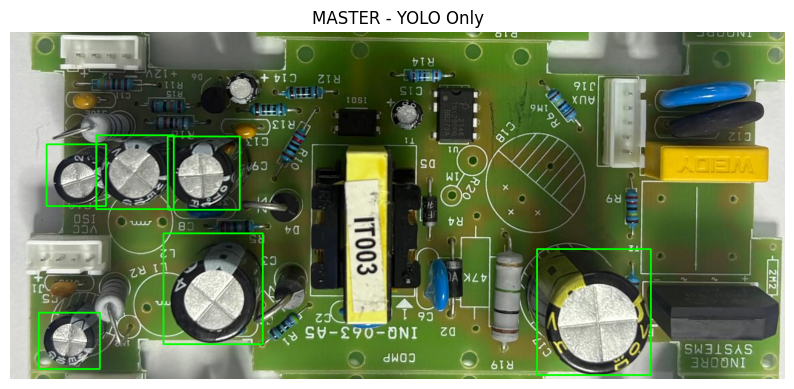

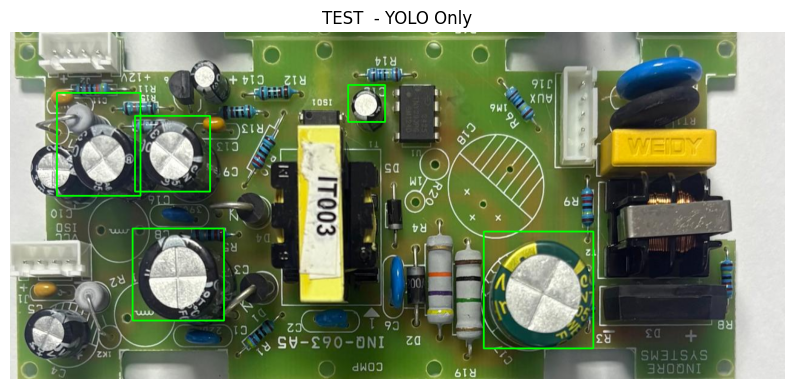

Saved: /content/pcb_step_by_step/master_yolo.png
Saved: /content/pcb_step_by_step/test_yolo.png
Master YOLO boxes: 6 | Test YOLO boxes: 5

STEP 2 — SAM refinement (YOLO + SAM)


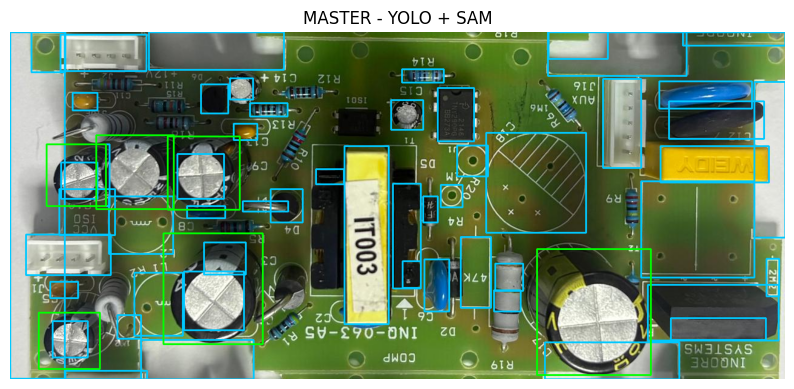

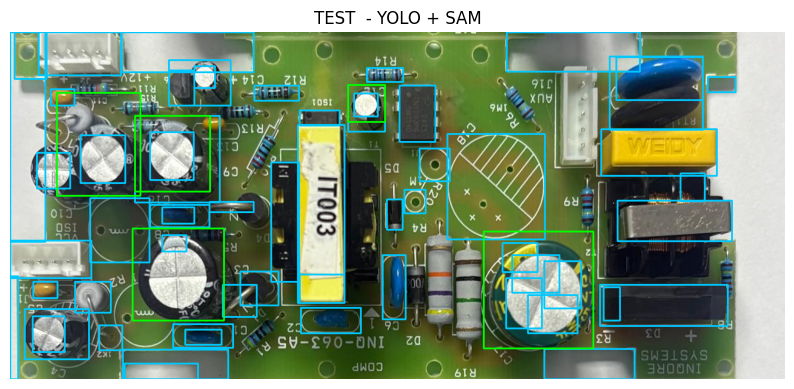

Saved: /content/pcb_step_by_step/master_sam.png
Saved: /content/pcb_step_by_step/test_sam.png
Master total boxes (after SAM): 59 | Test total boxes (after SAM): 63

STEP 3 — Compute difference (Master - Test) and mark on TEST only


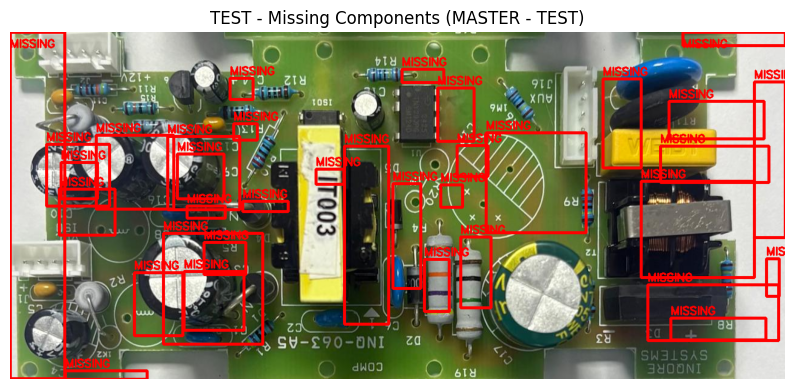

Missing count: 35
Saved difference JSON: /content/pcb_step_by_step/missing_difference.json
Saved missing-marked image: /content/pcb_step_by_step/test_missing_marked.png

All outputs in: /content/pcb_step_by_step
- master_sam.png
- master_yolo.png
- missing_difference.json
- test_missing_marked.png
- test_sam.png
- test_yolo.png


In [8]:
# ==============================================================
# STEP-BY-STEP: YOLO -> Tuned SAM (No OpenCV) with intermediate visuals
# ==============================================================

!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

import os, cv2, json, numpy as np, matplotlib.pyplot as plt, torch
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
from google.colab import files

# -------------------------
# CONFIG
# -------------------------
OUT_DIR = "/content/pcb_step_by_step"
os.makedirs(OUT_DIR, exist_ok=True)

YOLO_CONF = 0.6
MIN_BOX_AREA = 1000
MAX_BOX_AREA = 60000
IOU_THRESH = 0.45
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

# -------------------------
# LOAD MODELS
# -------------------------
MODEL_PATH = "/content/best.pt"
if not os.path.exists(MODEL_PATH):
    print("📥 Downloading YOLO model...")
    !pip install -q gdown
    !gdown --id 194ZizH82qzep_Oefe352CvjC8Ml55Ljd -O /content/best.pt

yolo = YOLO(MODEL_PATH)
print("✅ YOLO loaded:", MODEL_PATH)

sam_ckpt = "/content/sam_vit_b_01ec64.pth"
if not os.path.exists(sam_ckpt):
    print("📥 Downloading SAM model...")
    !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {sam_ckpt}

sam = sam_model_registry["vit_b"](checkpoint=sam_ckpt)
sam.to(device=DEVICE)
mask_generator = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=32,
    pred_iou_thresh=0.92,
    stability_score_thresh=0.96,
    crop_n_layers=1,
    min_mask_region_area=1200
)
print("✅ SAM ready on", DEVICE)

# -------------------------
# HELPERS
# -------------------------
def iou(boxA, boxB):
    xA, yA = max(boxA[0], boxB[0]), max(boxA[1], boxB[1])
    xB, yB = min(boxA[2], boxB[2]), min(boxA[3], boxB[3])
    inter = max(0, xB-xA) * max(0, yB-yA)
    areaA = (boxA[2]-boxA[0])*(boxA[3]-boxA[1])
    areaB = (boxB[2]-boxB[0])*(boxB[3]-boxB[1])
    return inter / (areaA + areaB - inter + 1e-9)

def box_center(box):
    x1,y1,x2,y2 = box
    return ((x1+x2)/2, (y1+y2)/2)

def are_similar(boxA, boxB, iou_thresh=IOU_THRESH, center_thresh=40):
    if iou(boxA, boxB) >= iou_thresh: return True
    cA, cB = box_center(boxA), box_center(boxB)
    return np.linalg.norm(np.array(cA)-np.array(cB)) < center_thresh

def is_valid_component(roi):
    if roi.size == 0: return False
    gray = cv2.cvtColor(roi, cv2.COLOR_BGR2GRAY)
    var = np.var(gray); mean = np.mean(gray)
    edges = cv2.Canny(gray, 40, 150)
    edge_density = np.sum(edges > 0) / (gray.shape[0]*gray.shape[1])
    return not (var < 80 or mean > 220 or edge_density < 0.02)

def merge_boxes(boxes, iou_threshold=0.4):
    merged = []
    for b in boxes:
        merged_flag = False
        for i, mb in enumerate(merged):
            if iou(b, mb) > iou_threshold:
                x1,y1,x2,y2 = min(b[0],mb[0]), min(b[1],mb[1]), max(b[2],mb[2]), max(b[3],mb[3])
                merged[i] = (x1,y1,x2,y2)
                merged_flag = True
                break
        if not merged_flag:
            merged.append(b)
    return merged

# -------------------------
# DETECTION (returns boxes and visualization image)
# -------------------------
def detect_yolo_only(image_bgr):
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
    boxes = []
    results = yolo.predict(source=image_rgb, conf=YOLO_CONF, device=DEVICE, verbose=False)
    if len(results) > 0 and len(results[0].boxes) > 0:
        for b in results[0].boxes.xyxy.cpu().numpy():
            x1,y1,x2,y2 = map(int,b)
            if (x2-x1)*(y2-y1) > MIN_BOX_AREA:
                boxes.append((x1,y1,x2,y2))
    vis = image_rgb.copy()
    for (x1,y1,x2,y2) in boxes:
        cv2.rectangle(vis, (x1,y1), (x2,y2), (0,255,0), 2)
    return boxes, vis

def detect_with_sam(image_bgr, yolo_boxes):
    # image_bgr: original BGR image
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
    boxes = yolo_boxes.copy()  # start with YOLO boxes
    masks = mask_generator.generate(image_rgb)
    for m in masks:
        seg = m["segmentation"].astype('uint8')
        x,y,w,h = cv2.boundingRect(seg)
        area = w*h
        if MIN_BOX_AREA < area < MAX_BOX_AREA:
            roi = image_bgr[y:y+h, x:x+w]
            if is_valid_component(roi):
                boxes.append((x,y,x+w,y+h))
    boxes = merge_boxes(boxes)
    vis = image_rgb.copy()
    for (x1,y1,x2,y2) in boxes:
        cv2.rectangle(vis, (x1,y1), (x2,y2), (0,200,255), 2)  # SAM/combined color
    # mark original YOLO boxes in green for clarity
    for (x1,y1,x2,y2) in yolo_boxes:
        cv2.rectangle(vis, (x1,y1), (x2,y2), (0,255,0), 2)
    return boxes, vis

# -------------------------
# UPLOAD IMAGES (Colab)
# -------------------------
print("📸 Upload MASTER (reference) then TEST (to compare) — in that order.")
uploaded = files.upload()
keys = list(uploaded.keys())
if len(keys) < 2:
    raise ValueError("Please upload both Master and Test images.")

master_img = cv2.imdecode(np.frombuffer(uploaded[keys[0]], np.uint8), cv2.IMREAD_COLOR)
test_img = cv2.imdecode(np.frombuffer(uploaded[keys[1]], np.uint8), cv2.IMREAD_COLOR)
if master_img is None or test_img is None:
    raise ValueError("Failed to load uploaded images. Re-upload please.")

# align sizes (resize test to master)
mh, mw = master_img.shape[:2]
test_img = cv2.resize(test_img, (mw, mh))

# -------------------------
# STEP 1 — YOLO only (show both)
# -------------------------
print("STEP 1 — YOLO detection (Master & Test)")
master_yolo_boxes, master_yolo_vis = detect_yolo_only(master_img)
test_yolo_boxes, test_yolo_vis = detect_yolo_only(test_img)

master_yolo_path = os.path.join(OUT_DIR, "master_yolo.png")
test_yolo_path   = os.path.join(OUT_DIR, "test_yolo.png")
cv2.imwrite(master_yolo_path, cv2.cvtColor(master_yolo_vis, cv2.COLOR_RGB2BGR))
cv2.imwrite(test_yolo_path,   cv2.cvtColor(test_yolo_vis,   cv2.COLOR_RGB2BGR))

# display
plt.figure(figsize=(10,6)); plt.imshow(master_yolo_vis); plt.title("MASTER - YOLO Only"); plt.axis("off"); plt.show()
plt.figure(figsize=(10,6)); plt.imshow(test_yolo_vis);  plt.title("TEST  - YOLO Only");  plt.axis("off"); plt.show()

print(f"Saved: {master_yolo_path}\nSaved: {test_yolo_path}")
print(f"Master YOLO boxes: {len(master_yolo_boxes)} | Test YOLO boxes: {len(test_yolo_boxes)}")

# -------------------------
# STEP 2 — SAM refinement (using tuned hyperparams) for master & test
# -------------------------
print("\nSTEP 2 — SAM refinement (YOLO + SAM)")

master_combined_boxes, master_sam_vis = detect_with_sam(master_img, master_yolo_boxes)
test_combined_boxes, test_sam_vis     = detect_with_sam(test_img, test_yolo_boxes)

master_sam_path = os.path.join(OUT_DIR, "master_sam.png")
test_sam_path   = os.path.join(OUT_DIR, "test_sam.png")
cv2.imwrite(master_sam_path, cv2.cvtColor(master_sam_vis, cv2.COLOR_RGB2BGR))
cv2.imwrite(test_sam_path,   cv2.cvtColor(test_sam_vis,   cv2.COLOR_RGB2BGR))

# display
plt.figure(figsize=(10,6)); plt.imshow(master_sam_vis); plt.title("MASTER - YOLO + SAM"); plt.axis("off"); plt.show()
plt.figure(figsize=(10,6)); plt.imshow(test_sam_vis);  plt.title("TEST  - YOLO + SAM");  plt.axis("off"); plt.show()

print(f"Saved: {master_sam_path}\nSaved: {test_sam_path}")
print(f"Master total boxes (after SAM): {len(master_combined_boxes)} | Test total boxes (after SAM): {len(test_combined_boxes)}")

# -------------------------
# STEP 3 — Compute differences (Master - Test) and mark on TEST only
# -------------------------
print("\nSTEP 3 — Compute difference (Master - Test) and mark on TEST only")

missing = []
for mb in master_combined_boxes:
    if not any(are_similar(mb, tb) for tb in test_combined_boxes):
        missing.append(mb)
missing = merge_boxes(missing)

# Build difference JSON (only missing)
difference_json = {"missing_components":[{"x1":x1,"y1":y1,"x2":x2,"y2":y2} for (x1,y1,x2,y2) in missing]}

diff_path = os.path.join(OUT_DIR, "missing_difference.json")
with open(diff_path, "w") as f:
    json.dump(difference_json, f, indent=4)

# visualize missing on TEST only
final_vis = cv2.cvtColor(test_img.copy(), cv2.COLOR_BGR2RGB)
for (x1,y1,x2,y2) in missing:
    cv2.rectangle(final_vis, (x1,y1), (x2,y2), (255,0,0), 3)
    cv2.putText(final_vis, "MISSING", (x1, max(25, y1-6)),
                cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255,0,0), 2)

save_missing_img = os.path.join(OUT_DIR, "test_missing_marked.png")
cv2.imwrite(save_missing_img, cv2.cvtColor(final_vis, cv2.COLOR_RGB2BGR))

# display
plt.figure(figsize=(10,6)); plt.imshow(final_vis); plt.title("TEST - Missing Components (MASTER - TEST)"); plt.axis("off"); plt.show()

print(f"Missing count: {len(missing)}")
print(f"Saved difference JSON: {diff_path}")
print(f"Saved missing-marked image: {save_missing_img}")

# -------------------------
# DONE: show paths for download
# -------------------------
print("\nAll outputs in:", OUT_DIR)
for fname in sorted(os.listdir(OUT_DIR)):
    print("-", fname)


In [10]:
# FastSAM manual install (IDEA-Research official)
!git clone https://github.com/CASIA-IVA-Lab/FastSAM.git
%cd FastSAM
!pip install -r requirements.txt
!pip install -e .

# HQ-SAM manual install (Shaun-Long)
!git clone https://github.com/Shaun-Long/HQ-SAM.git
%cd HQ-SAM
!pip install -r requirements.txt
!pip install -e .
%cd /content


Cloning into 'FastSAM'...
remote: Enumerating objects: 1329, done.
remote: Counting objects: 100% (401/401), done.
remote: Compressing objects: 100% (93/93), done.
remote: Total 1329 (delta 346), reused 308 (delta 308), pack-reused 928 (from 1)
Receiving objects: 100% (1329/1329), 72.56 MiB | 22.22 MiB/s, done.
Resolving deltas: 100% (542/542), done.
/content/FastSAM
INFO: pip is looking at multiple versions of mdit-py-plugins to determine which version is compatible with other requirements. This could take a while.
INFO: pip is still looking at multiple versions of mdit-py-plugins to determine which version is compatible with other requirements. This could take a while.
INFO: This is taking longer than usual. You might need to provide the dependency resolver with stricter constraints to reduce runtime. See https://pip.pypa.io/warnings/backtracking for guidance. If you want to abort this run, press Ctrl + C.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 19.7/19.7 MB 34.2 MB/s eta 0:00:00

✅ YOLO loaded: /content/best.pt

Attempting to install FastSAM and HQ-SAM (if available)...
  error: subprocess-exited-with-error
  
  × git clone --filter=blob:none --quiet https://github.com/IDEA-Research/FastSAM.git /tmp/pip-req-build-afl5j9v6 did not run successfully.
  │ exit code: 128
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
error: subprocess-exited-with-error

× git clone --filter=blob:none --quiet https://github.com/IDEA-Research/FastSAM.git /tmp/pip-req-build-afl5j9v6 did not run successfully.
│ exit code: 128
╰─> See above for output.

note: This error originates from a subprocess, and is likely not a problem with pip.
⚠️ FastSAM not available — will use segment-anything SAM as fallback.
ERROR: Could not find a version that satisfies the requirement hq-sam (from versions: none)
ERROR: No matching distribution found for hq-sam
  error: subprocess-exited-with-error
  
  × git clone --filter=blob:none -

Saving B.jpeg to B (1).jpeg
Saving A.jpeg to A (1).jpeg

STEP 1: YOLO detection (Master & Test)
Saved master_yolo.png and test_yolo.png


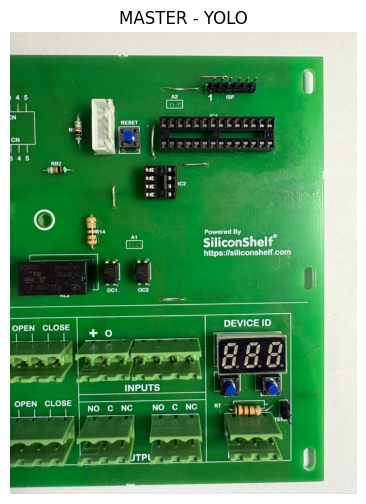

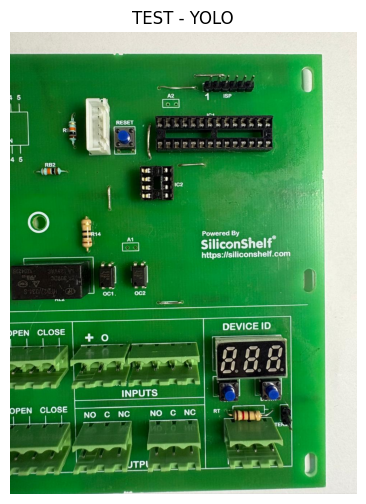


STEP 2: Running FastSAM (or SAM fallback) to refine detections
Saved master_fastsam.png and test_fastsam.png


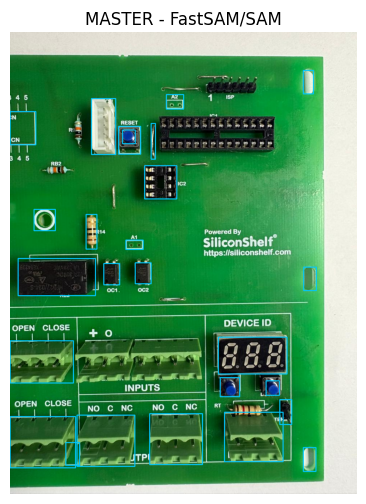

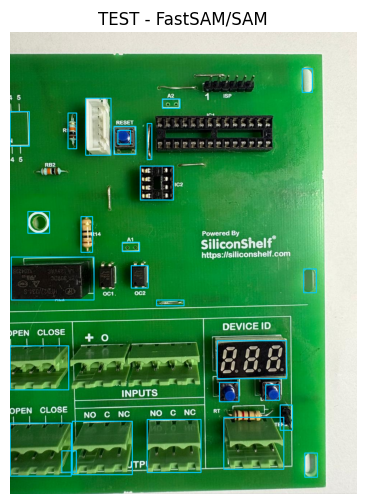


STEP 3: HQ-SAM refinement (if available)
Saved master_hqsam.png and test_hqsam.png


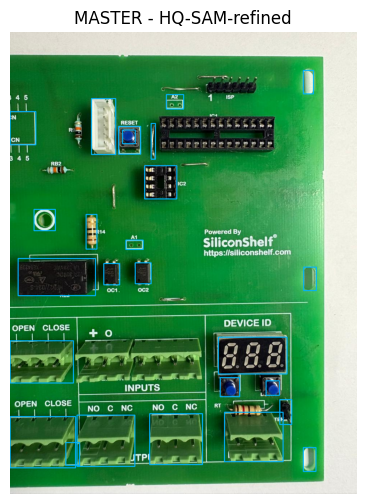

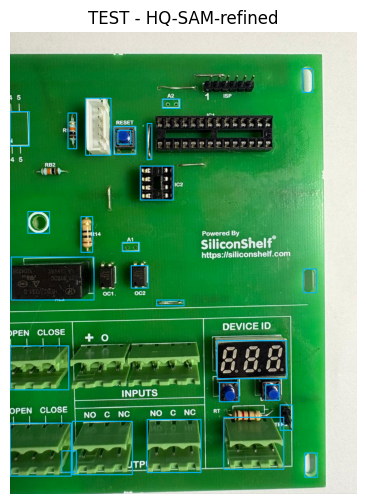


STEP 4: Computing differences (Master - Test) with histogram similarity


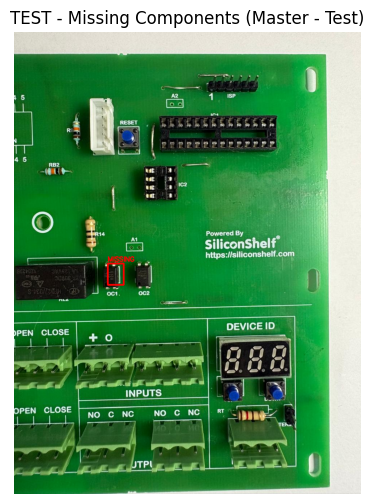


Done.
Outputs saved in: /content/pcb_fastsam_hqsam
 - master_yolo.png, test_yolo.png
 - master_fastsam.png, test_fastsam.png
 - master_hqsam.png, test_hqsam.png
 - test_missing_strict.png
 - missing_difference.json


In [11]:
# ==============================================================
# TRY: YOLOv8 -> FastSAM -> HQ-SAM (with safe fallbacks to SAM)
# Step-by-step visuals: YOLO only -> (Fast)SAM -> (HQ-SAM refine) -> Differences (Master - Test)
# ==============================================================
!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

import os, sys, cv2, json, numpy as np, matplotlib.pyplot as plt, traceback, torch
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
from google.colab import files

OUT_DIR = "/content/pcb_fastsam_hqsam"
os.makedirs(OUT_DIR, exist_ok=True)

# -------------------------
# CONFIG
# -------------------------
YOLO_CONF = 0.6
MIN_BOX_AREA = 1000
MAX_BOX_AREA = 60000
IOU_THRESH = 0.45
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

# -------------------------
# LOAD YOLO
# -------------------------
MODEL_PATH = "/content/best.pt"
if not os.path.exists(MODEL_PATH):
    print("Downloading YOLO model to /content/best.pt ...")
    !pip install -q gdown
    !gdown --id 194ZizH82qzep_Oefe352CvjC8Ml55Ljd -O /content/best.pt

yolo = YOLO(MODEL_PATH)
print("✅ YOLO loaded:", MODEL_PATH)

# -------------------------
# TRY TO INSTALL AND IMPORT FastSAM and HQ-SAM (best-effort)
# -------------------------
use_fastsam = False
use_hqsam = False
fastsam = None
hqsam = None

print("\nAttempting to install FastSAM and HQ-SAM (if available)...")
# Try common FastSAM repo variants (best-effort). If they fail, we'll fallback to SAM.
try:
    # try PyPI first (if present)
    !pip install -q fastsam
    import fastsam as _fs
    fastsam = _fs
    use_fastsam = True
    print("✔️ fastsam (PyPI) imported.")
except Exception:
    try:
        # try a GitHub variant (IDEA-Research/FastSAM) (best-effort)
        !pip install -q git+https://github.com/IDEA-Research/FastSAM.git
        import fastsam as _fs
        fastsam = _fs
        use_fastsam = True
        print("✔️ FastSAM installed from IDEA-Research/FastSAM.")
    except Exception:
        print("⚠️ FastSAM not available — will use segment-anything SAM as fallback.")

# Try HQ-SAM (best-effort)
try:
    !pip install -q hq-sam
    import hq_sam as _hq
    hqsam = _hq
    use_hqsam = True
    print("✔️ hq-sam (PyPI) imported.")
except Exception:
    try:
        !pip install -q git+https://github.com/Shaun-Long/HQ-SAM.git
        import hq_sam as _hq
        hqsam = _hq
        use_hqsam = True
        print("✔️ HQ-SAM installed from GitHub.")
    except Exception:
        print("⚠️ HQ-SAM not available — will use SAM or skip HQ refinement.")

# -------------------------
# Prepare SAM (fallback and default)
# -------------------------
sam_ckpt = "/content/sam_vit_b_01ec64.pth"
if not os.path.exists(sam_ckpt):
    print("Downloading SAM (ViT-B) checkpoint...")
    !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {sam_ckpt}

# instantiate base SAM for fallback & HQ refine (if needed)
sam = sam_model_registry["vit_b"](checkpoint=sam_ckpt)
sam.to(device=DEVICE)

# Build mask generator for the (fallback) SAM
sam_mask_generator = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=32,
    pred_iou_thresh=0.92,
    stability_score_thresh=0.96,
    crop_n_layers=1,
    min_mask_region_area=1200
)

print("\nModel availability summary:")
print("  FastSAM:", use_fastsam)
print("  HQ-SAM:", use_hqsam)
print("  SAM (fallback): True")

# -------------------------
# Helper functions (IoU, similarity, merging)
# -------------------------
def iou(boxA, boxB):
    xA, yA = max(boxA[0], boxB[0]), max(boxA[1], boxB[1])
    xB, yB = min(boxA[2], boxB[2]), min(boxA[3], boxB[3])
    inter = max(0, xB-xA) * max(0, yB-yA)
    areaA = (boxA[2]-boxA[0])*(boxA[3]-boxA[1])
    areaB = (boxB[2]-boxB[0])*(boxB[3]-boxB[1])
    return inter / (areaA + areaB - inter + 1e-9)

def box_center(box):
    x1,y1,x2,y2 = box
    return ((x1+x2)/2, (y1+y2)/2)

def are_similar_hist(boxA, boxB, imgA, imgB, iou_thresh=0.35, center_thresh=40, hist_thresh=0.55):
    # IoU quick accept
    if iou(boxA, boxB) >= iou_thresh:
        return True
    # center distance reject
    cA, cB = box_center(boxA), box_center(boxB)
    if np.linalg.norm(np.array(cA)-np.array(cB)) > center_thresh:
        return False
    # histogram similarity on HSV 2D (H,S)
    x1A,y1A,x2A,y2A = map(int, boxA); x1B,y1B,x2B,y2B = map(int, boxB)
    roiA = imgA[y1A:y2A, x1A:x2A]; roiB = imgB[y1B:y2B, x1B:x2B]
    if roiA.size==0 or roiB.size==0:
        return False
    try:
        hA = cv2.calcHist([cv2.cvtColor(roiA, cv2.COLOR_BGR2HSV)], [0,1], None, [30,32], [0,180,0,256])
        hB = cv2.calcHist([cv2.cvtColor(roiB, cv2.COLOR_BGR2HSV)], [0,1], None, [30,32], [0,180,0,256])
        cv2.normalize(hA, hA); cv2.normalize(hB, hB)
        score = float(cv2.compareHist(hA, hB, cv2.HISTCMP_CORREL))
        return score >= hist_thresh
    except Exception:
        return False

def merge_boxes(boxes, iou_threshold=0.4):
    merged = []
    for b in boxes:
        merged_flag = False
        for i, mb in enumerate(merged):
            if iou(b, mb) > iou_threshold:
                x1,y1,x2,y2 = min(b[0],mb[0]), min(b[1],mb[1]), max(b[2],mb[2]), max(b[3],mb[3])
                merged[i] = (x1,y1,x2,y2)
                merged_flag = True
                break
        if not merged_flag:
            merged.append(b)
    return merged

# -------------------------
# Detection functions
# -------------------------
def detect_yolo(image_bgr):
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
    boxes = []
    results = yolo.predict(source=image_rgb, conf=YOLO_CONF, device=DEVICE, verbose=False)
    if len(results)>0 and len(results[0].boxes)>0:
        for b in results[0].boxes.xyxy.cpu().numpy():
            x1,y1,x2,y2 = map(int,b)
            if (x2-x1)*(y2-y1) > MIN_BOX_AREA:
                boxes.append((x1,y1,x2,y2))
    return boxes

def detect_fastsam(image_bgr, yolo_boxes=None):
    # If FastSAM present, use it. Otherwise fallback to sam_mask_generator.
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
    boxes = [] if yolo_boxes is None else list(yolo_boxes)
    if use_fastsam:
        try:
            # Common FastSAM pattern (may vary across implementations)
            # Attempt to use a common API: FastSAM(model='fast_sam.pt') or fastsam.build_model()
            if hasattr(fastsam, "FastSAM"):
                # load default weights if needed; many fastsam implementations require a checkpoint
                fs = fastsam.FastSAM(checkpoint=None)  # None => use bundled (if implemented)
                masks = fs.predict(image_rgb, retina_masks=True)  # attempt common API
                # masks may be dict containing 'masks' or list of masks; try sensible extraction
                ms = masks.get("masks", masks if isinstance(masks, list) else None)
                if ms is None:
                    ms = masks
                for seg in ms:
                    # seg: boolean 2D mask
                    segu = (seg.astype('uint8')*255).astype('uint8')
                    x,y,w,h = cv2.boundingRect(segu)
                    area = w*h
                    if MIN_BOX_AREA < area < MAX_BOX_AREA:
                        roi = image_bgr[y:y+h, x:x+w]
                        if is_valid_comp(roi):
                            boxes.append((x,y,x+w,y+h))
            else:
                # unknown API — fall back to SAM generator
                raise RuntimeError("FastSAM imported but API unknown; falling back to SAM")
        except Exception as e:
            print("⚠️ FastSAM usage failed:", e)
            print("Falling back to Segment-Anything SAM for detection.")
            masks = sam_mask_generator.generate(image_rgb)
            for m in masks:
                seg = m["segmentation"].astype('uint8')
                x,y,w,h = cv2.boundingRect(seg)
                area = w*h
                if MIN_BOX_AREA < area < MAX_BOX_AREA:
                    roi = image_bgr[y:y+h, x:x+w]
                    if is_valid_component(roi):
                        boxes.append((x,y,x+w,y+h))
    else:
        masks = sam_mask_generator.generate(image_rgb)
        for m in masks:
            seg = m["segmentation"].astype('uint8')
            x,y,w,h = cv2.boundingRect(seg)
            area = w*h
            if MIN_BOX_AREA < area < MAX_BOX_AREA:
                roi = image_bgr[y:y+h, x:x+w]
                if is_valid_component(roi):
                    boxes.append((x,y,x+w,y+h))
    boxes = merge_boxes(boxes)
    return boxes

def detect_hqsam_refine(image_bgr, boxes):
    # If HQ-SAM present, attempt refine; else return boxes unchanged
    if not use_hqsam:
        return boxes
    try:
        # Attempt to use a generic HQ-SAM API; these vary in repos.
        # We'll call hypothetical refine function; if it fails, skip.
        if hasattr(hqsam, "refine_masks"):
            return hqsam.refine_masks(image_bgr, boxes)
        elif hasattr(hqsam, "HQSam"):
            hq = hqsam.HQSam(checkpoint=None)
            return hq.refine_boxes(image_bgr, boxes)
        else:
            print("⚠️ HQ-SAM imported but API unknown — skipping HQ refinement.")
            return boxes
    except Exception as e:
        print("⚠️ HQ-SAM refine failed:", e)
        return boxes

# small helper used in fastsam block (if API unknown)
def is_valid_component(roi):
    if roi.size == 0: return False
    gray = cv2.cvtColor(roi, cv2.COLOR_BGR2GRAY)
    var = np.var(gray); mean = np.mean(gray)
    edges = cv2.Canny(gray, 40, 150)
    edge_density = np.sum(edges > 0) / (gray.shape[0]*gray.shape[1])
    return not (var < 80 or mean > 220 or edge_density < 0.02)

# -------------------------
# YOLO-only visual function
# -------------------------
def visualize_boxes_on_rgb(rgb_img, boxes, color=(0,255,0), thickness=2, label=None):
    vis = rgb_img.copy()
    for (x1,y1,x2,y2) in boxes:
        cv2.rectangle(vis, (x1,y1), (x2,y2), color, thickness)
        if label:
            cv2.putText(vis, label, (x1, max(12, y1+12)), cv2.FONT_HERSHEY_SIMPLEX, 0.4, color, 1)
    return vis

# -------------------------
# RUN: Upload images in Colab (Master then Test)
# -------------------------
print("\nUpload MASTER and TEST images (Master first then Test).")
uploaded = files.upload()
keys = list(uploaded.keys())
if len(keys) < 2:
    raise ValueError("Upload two images: MASTER then TEST")

master_img = cv2.imdecode(np.frombuffer(uploaded[keys[0]], np.uint8), cv2.IMREAD_COLOR)
test_img   = cv2.imdecode(np.frombuffer(uploaded[keys[1]], np.uint8), cv2.IMREAD_COLOR)
if master_img is None or test_img is None:
    raise ValueError("Failed to read uploaded images.")

# align sizes
mh, mw = master_img.shape[:2]
test_img = cv2.resize(test_img, (mw, mh))

# -------------------------
# STEP 1: YOLO detections
# -------------------------
print("\nSTEP 1: YOLO detection (Master & Test)")
m_yolo = detect_yolo(master_img)
t_yolo = detect_yolo(test_img)
m_yolo_vis = visualize_boxes_on_rgb(cv2.cvtColor(master_img, cv2.COLOR_BGR2RGB), m_yolo, color=(0,255,0))
t_yolo_vis = visualize_boxes_on_rgb(cv2.cvtColor(test_img, cv2.COLOR_BGR2RGB), t_yolo, color=(0,255,0))

cv2.imwrite(os.path.join(OUT_DIR, "master_yolo.png"), cv2.cvtColor(m_yolo_vis, cv2.COLOR_RGB2BGR))
cv2.imwrite(os.path.join(OUT_DIR, "test_yolo.png"), cv2.cvtColor(t_yolo_vis, cv2.COLOR_RGB2BGR))
print("Saved master_yolo.png and test_yolo.png")

plt.figure(figsize=(10,6)); plt.imshow(m_yolo_vis); plt.title("MASTER - YOLO"); plt.axis("off"); plt.show()
plt.figure(figsize=(10,6)); plt.imshow(t_yolo_vis); plt.title("TEST - YOLO"); plt.axis("off"); plt.show()

# -------------------------
# STEP 2: FastSAM or SAM detection (refinement)
# -------------------------
print("\nSTEP 2: Running FastSAM (or SAM fallback) to refine detections")

m_fsam = detect_fastsam(master_img, yolo_boxes=m_yolo)
t_fsam = detect_fastsam(test_img, yolo_boxes=t_yolo)

m_fsam_vis = visualize_boxes_on_rgb(cv2.cvtColor(master_img, cv2.COLOR_BGR2RGB), m_fsam, color=(0,200,255))
t_fsam_vis = visualize_boxes_on_rgb(cv2.cvtColor(test_img, cv2.COLOR_BGR2RGB), t_fsam, color=(0,200,255))

cv2.imwrite(os.path.join(OUT_DIR, "master_fastsam.png"), cv2.cvtColor(m_fsam_vis, cv2.COLOR_RGB2BGR))
cv2.imwrite(os.path.join(OUT_DIR, "test_fastsam.png"), cv2.cvtColor(t_fsam_vis, cv2.COLOR_RGB2BGR))
print("Saved master_fastsam.png and test_fastsam.png")

plt.figure(figsize=(10,6)); plt.imshow(m_fsam_vis); plt.title("MASTER - FastSAM/SAM"); plt.axis("off"); plt.show()
plt.figure(figsize=(10,6)); plt.imshow(t_fsam_vis); plt.title("TEST - FastSAM/SAM"); plt.axis("off"); plt.show()

# -------------------------
# STEP 3: HQ-SAM refinement (optional)
# -------------------------
print("\nSTEP 3: HQ-SAM refinement (if available)")
m_hq = detect_hqsam_refine(master_img, m_fsam)
t_hq = detect_hqsam_refine(test_img, t_fsam)

m_hq_vis = visualize_boxes_on_rgb(cv2.cvtColor(master_img, cv2.COLOR_BGR2RGB), m_hq, color=(0,180,255))
t_hq_vis = visualize_boxes_on_rgb(cv2.cvtColor(test_img, cv2.COLOR_BGR2RGB), t_hq, color=(0,180,255))

cv2.imwrite(os.path.join(OUT_DIR, "master_hqsam.png"), cv2.cvtColor(m_hq_vis, cv2.COLOR_RGB2BGR))
cv2.imwrite(os.path.join(OUT_DIR, "test_hqsam.png"), cv2.cvtColor(t_hq_vis, cv2.COLOR_RGB2BGR))
print("Saved master_hqsam.png and test_hqsam.png")

plt.figure(figsize=(10,6)); plt.imshow(m_hq_vis); plt.title("MASTER - HQ-SAM-refined"); plt.axis("off"); plt.show()
plt.figure(figsize=(10,6)); plt.imshow(t_hq_vis); plt.title("TEST - HQ-SAM-refined"); plt.axis("off"); plt.show()

# -------------------------
# STEP 4: Compute strict difference (Master - Test) using histogram similarity
# -------------------------
print("\nSTEP 4: Computing differences (Master - Test) with histogram similarity")

master_boxes = merge_boxes(m_hq)
test_boxes   = merge_boxes(t_hq)

missing = []
for mb in master_boxes:
    if not any(are_similar_hist(mb, tb, master_img, test_img) for tb in test_boxes):
        missing.append(mb)
missing = merge_boxes(missing)

difference_json = {"missing_components":[{"x1":x1,"y1":y1,"x2":x2,"y2":y2} for (x1,y1,x2,y2) in missing]}
diff_path = os.path.join(OUT_DIR, "missing_difference.json")
with open(diff_path, "w") as f:
    json.dump(difference_json, f, indent=2)

# visualize missing on TEST only
final_vis = cv2.cvtColor(test_img.copy(), cv2.COLOR_BGR2RGB)
for (x1,y1,x2,y2) in missing:
    cv2.rectangle(final_vis, (x1,y1), (x2,y2), (255,0,0), 3)
    cv2.putText(final_vis, "MISSING", (x1, max(25, y1-6)),
                cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255,0,0), 2)
save_missing_img = os.path.join(OUT_DIR, "test_missing_strict.png")
cv2.imwrite(save_missing_img, cv2.cvtColor(final_vis, cv2.COLOR_RGB2BGR))

plt.figure(figsize=(10,6)); plt.imshow(final_vis); plt.title("TEST - Missing Components (Master - Test)"); plt.axis("off"); plt.show()

print("\nDone.")
print("Outputs saved in:", OUT_DIR)
print(" - master_yolo.png, test_yolo.png")
print(" - master_fastsam.png, test_fastsam.png")
print(" - master_hqsam.png, test_hqsam.png")
print(" - test_missing_strict.png")
print(" - missing_difference.json")


⚠️ fastsam not available — falling back to SAM-only for that stage.
✅ YOLO loaded: /content/best.pt
✅ SAM ready on cuda

===== Processing master =====
YOLO -> 5 boxes
SAM -> 70 boxes
FastSAM -> 0 boxes (proposed)
FINAL merged -> 70 components

===== Processing test =====
YOLO -> 6 boxes
SAM -> 77 boxes
FastSAM -> 0 boxes (proposed)
FINAL merged -> 79 components

Saved intermediate images to: /content/pcb_output_full


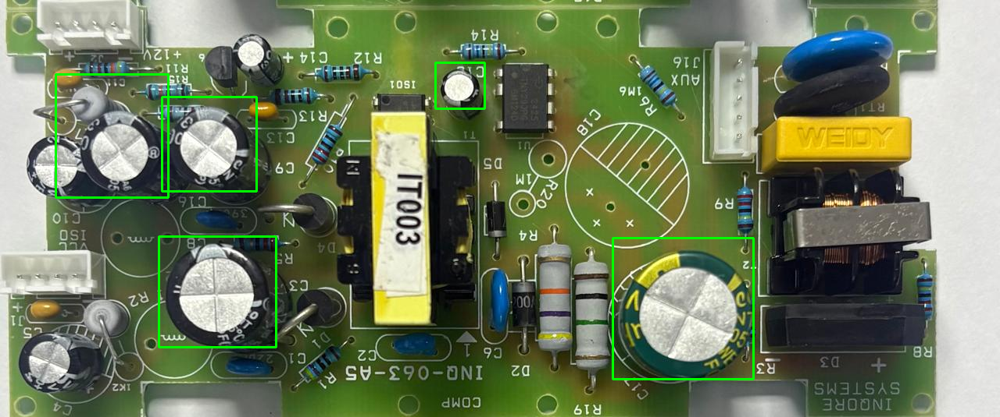

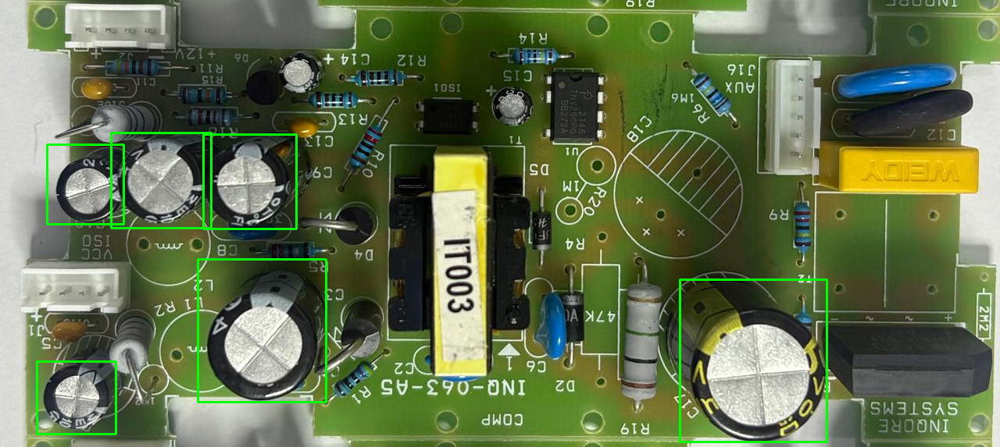

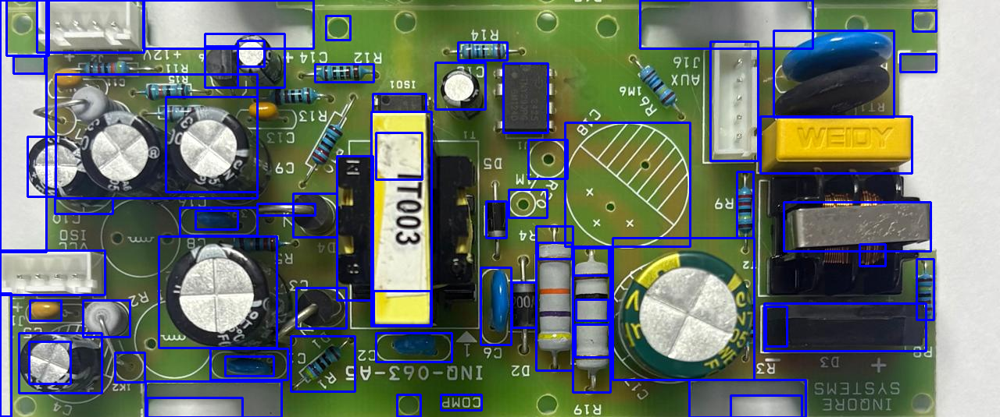

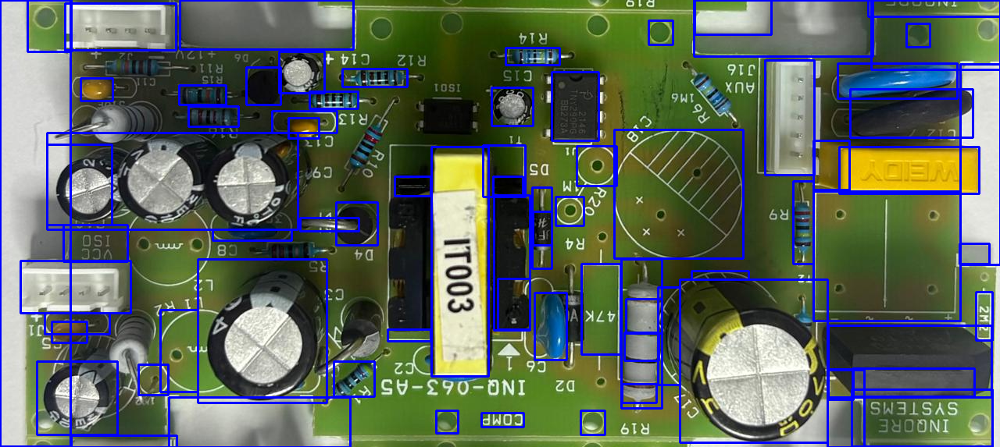


🧾 JSON saved to: /content/pcb_output_full/pcb_comparison_results.json
{
    "master_components": [
        {
            "x1": 203,
            "y1": 303,
            "x2": 354,
            "y2": 446
        },
        {
            "x1": 207,
            "y1": 124,
            "x2": 329,
            "y2": 246
        },
        {
            "x1": 784,
            "y1": 305,
            "x2": 965,
            "y2": 487
        },
        {
            "x1": 557,
            "y1": 80,
            "x2": 621,
            "y2": 140
        },
        {
            "x1": 71,
            "y1": 95,
            "x2": 329,
            "y2": 254
        },
        {
            "x1": 288,
            "y1": 457,
            "x2": 350,
            "y2": 482
        },
        {
            "x1": 481,
            "y1": 427,
            "x2": 578,
            "y2": 464
        },
        {
            "x1": 478,
            "y1": 373,
            "x2": 551,
            "y2": 417
        },
       

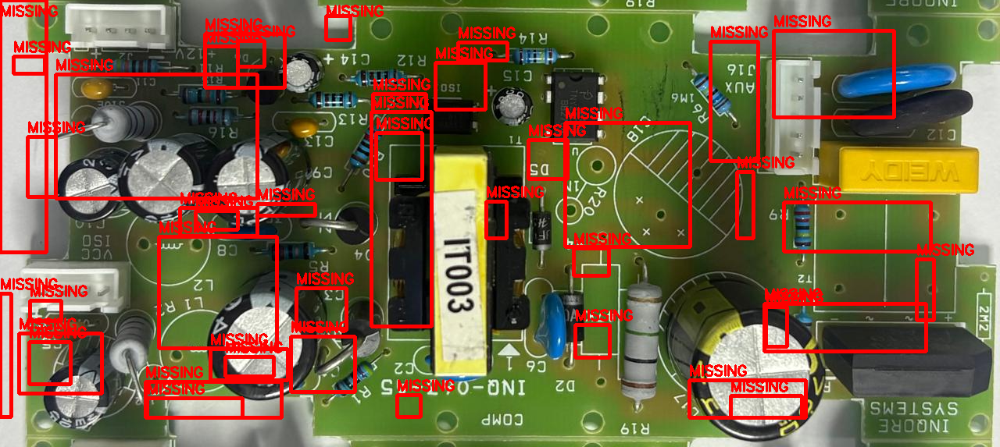


✅ Done — all outputs in /content/pcb_output_full


In [13]:
# ==============================================================
# 🔁 END-TO-END: YOLO -> SAM -> (FastSAM optional) -> HQ-emulate
#         + Master vs Test comparison (missing marked on TEST)
# ==============================================================
# Run in Colab. Make sure /content/best.pt, /content/Masterrrrrr.jpeg and /content/tesssttt.jpeg exist
# If FastSAM is installed in your env it will be used, otherwise we fallback to SAM only.
# ==============================================================

# Install main deps (comment out if already installed)
!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

import os, cv2, json, numpy as np, matplotlib.pyplot as plt, torch
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
from PIL import Image

# ---------------------------
# Optional FastSAM import (guarded)
# ---------------------------
use_fastsam = False
try:
    from fastsam import FastSAM, FastSAMPrompt
    use_fastsam = True
    print("✅ fastsam available and will be used when possible.")
except Exception as e:
    print("⚠️ fastsam not available — falling back to SAM-only for that stage.")

# ---------------------------
# Config / Paths
# ---------------------------
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
OUT_DIR = "/content/pcb_output_full"
os.makedirs(OUT_DIR, exist_ok=True)

YOLO_PATH = "/content/best.pt"                 # change if needed
MASTER_PATH = "/content/Masterrrrrr.jpeg"      # your master image
TEST_PATH   = "/content/tesssttt.jpeg"         # your test image
SAM_CKPT = "/content/sam_vit_b_01ec64.pth"

CONF_YOLO = 0.55
MIN_BOX_AREA = 800
MAX_BOX_AREA = 60000
IOU_MERGE = 0.4
IOU_SIMILAR = 0.45
CENTER_THRESH = 40

# ---------------------------
# Utilities
# ---------------------------
def iou(a,b):
    xA, yA = max(a[0], b[0]), max(a[1], b[1])
    xB, yB = min(a[2], b[2]), min(a[3], b[3])
    inter = max(0, xB-xA) * max(0, yB-yA)
    areaA = (a[2]-a[0])*(a[3]-a[1])
    areaB = (b[2]-b[0])*(b[3]-b[1])
    return inter / (areaA + areaB - inter + 1e-9)

def merge_boxes(boxes, iou_threshold=IOU_MERGE):
    merged=[]
    for b in boxes:
        merged_flag=False
        for i,mb in enumerate(merged):
            if iou(b,mb)>iou_threshold:
                merged[i] = (min(b[0],mb[0]), min(b[1],mb[1]), max(b[2],mb[2]), max(b[3],mb[3]))
                merged_flag=True
                break
        if not merged_flag:
            merged.append(b)
    return merged

def box_center(box):
    x1,y1,x2,y2 = box
    return ((x1+x2)/2, (y1+y2)/2)

def are_similar(boxA, boxB, iou_thresh=IOU_SIMILAR, center_thresh=CENTER_THRESH):
    if iou(boxA, boxB) >= iou_thresh:
        return True
    cA, cB = box_center(boxA), box_center(boxB)
    return np.linalg.norm(np.array(cA)-np.array(cB)) < center_thresh

def is_valid_component(roi):
    if roi.size == 0:
        return False
    gray = cv2.cvtColor(roi, cv2.COLOR_BGR2GRAY)
    var = np.var(gray); mean = np.mean(gray)
    edges = cv2.Canny(gray, 50, 150)
    edge_density = np.sum(edges>0) / (gray.shape[0]*gray.shape[1] + 1e-9)
    if var < 80 or mean > 225 or edge_density < 0.02:
        return False
    return True

def draw_boxes_and_save(rgb_img, boxes, outpath, labels=None, color=(0,255,0), thickness=2, show=False, title=None):
    vis = rgb_img.copy()
    for i,(x1,y1,x2,y2) in enumerate(boxes):
        cv2.rectangle(vis, (x1,y1),(x2,y2), color, thickness)
        if labels is not None:
            cv2.putText(vis, labels[i], (x1, max(20,y1-6)), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 1)
    # save BGR
    cv2.imwrite(outpath, cv2.cvtColor(vis, cv2.COLOR_RGB2BGR))
    if show:
        plt.figure(figsize=(8,8)); plt.imshow(vis); plt.axis("off");
        if title: plt.title(title)
        plt.show()
    return outpath

# ---------------------------
# Load models
# ---------------------------
# YOLO
if not os.path.exists(YOLO_PATH):
    raise FileNotFoundError(f"YOLO model not found at {YOLO_PATH}")
yolo = YOLO(YOLO_PATH)
print("✅ YOLO loaded:", YOLO_PATH)

# SAM (segment-anything)
if not os.path.exists(SAM_CKPT):
    print("📥 Downloading SAM checkpoint...")
    !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {SAM_CKPT}
sam = sam_model_registry["vit_b"](checkpoint=SAM_CKPT).to(DEVICE)
sam_mask_gen = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=32,
    pred_iou_thresh=0.90,
    stability_score_thresh=0.95,
    crop_n_layers=1,
    min_mask_region_area=1000
)
print("✅ SAM ready on", DEVICE)

# FastSAM model (if available)
fastsam_model = None
if use_fastsam:
    # supply path to the FastSAM checkpoint file if you have it, otherwise default loader will refer to FastSAM weights
    try:
        FASTSAM_PT = "FastSAM-x.pt"
        if not os.path.exists(FASTSAM_PT):
            # try to download official release (if available)
            !wget -q https://github.com/CASIA-IVA-Lab/FastSAM/releases/download/v0.1.1/FastSAM-x.pt -O {FASTSAM_PT}
        fastsam_model = FastSAM(FASTSAM_PT)
        print("✅ FastSAM loaded.")
    except Exception as e:
        print("⚠️ FastSAM failed to load:", e)
        fastsam_model = None
        use_fastsam = False

# HQ-SAM emulation function (refinement / intersection)
def refine_hq_emulation(mask_list):
    """
    Emulate HQ-SAM refinement by extracting bounding boxes from masks and merging.
    Mask list expected as list/ndarray of binary masks (H,W).
    """
    boxes = []
    if mask_list is None:
        return []
    for m in mask_list:
        try:
            mm = (m>0).astype('uint8')
            contours,_ = cv2.findContours(mm, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            for c in contours:
                x,y,w,h = cv2.boundingRect(c)
                boxes.append((x,y,x+w,y+h))
        except Exception:
            continue
    return merge_boxes(boxes)

# ---------------------------
# Single-image detection: returns dict with per-model boxes and final merged
# ---------------------------
def detect_pipeline(image_path, name="img"):
    print(f"\n===== Processing {name} =====")
    bgr = cv2.imread(image_path)
    if bgr is None:
        raise FileNotFoundError(f"Image not found: {image_path}")
    # Keep original size for visualization, but YOLO/SAM works on arrays directly
    rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
    h,w = rgb.shape[:2]

    # 1) YOLO
    yolo_boxes=[]
    res = yolo(rgb, conf=CONF_YOLO, device=DEVICE, verbose=False)
    if len(res)>0:
        for b in res[0].boxes.xyxy.cpu().numpy():
            x1,y1,x2,y2 = map(int, b[:4])
            if (x2-x1)*(y2-y1) >= MIN_BOX_AREA:
                yolo_boxes.append((x1,y1,x2,y2))
    yolo_boxes = merge_boxes(yolo_boxes)
    print(f"YOLO -> {len(yolo_boxes)} boxes")

    # Save YOLO visualization
    draw_boxes_and_save(rgb, yolo_boxes, os.path.join(OUT_DIR, f"{name}_yolo.png"), color=(0,255,0), show=False)

    # 2) SAM (only on uncovered areas)
    mask_yolo = np.zeros((h,w), dtype=np.uint8)
    for (x1,y1,x2,y2) in yolo_boxes:
        cv2.rectangle(mask_yolo, (x1,y1), (x2,y2), 255, -1)
    inverse_mask = cv2.bitwise_not(mask_yolo)
    uncovered = cv2.bitwise_and(rgb, rgb, mask=inverse_mask)

    sam_boxes=[]
    try:
        masks = sam_mask_gen.generate(uncovered)
        for m in masks:
            seg = m["segmentation"].astype("uint8")
            x,y,ww,hh = cv2.boundingRect(seg)
            area = ww*hh
            if MIN_BOX_AREA < area < MAX_BOX_AREA:
                # convert to original coords: uncovered is same size, mask used so coords are correct
                roi = bgr[y:y+hh, x:x+ww]
                if is_valid_component(roi):
                    sam_boxes.append((x,y,x+ww,y+hh))
    except Exception as e:
        print("SAM generation error:", e)
    sam_boxes = merge_boxes(sam_boxes)
    print(f"SAM -> {len(sam_boxes)} boxes")
    draw_boxes_and_save(rgb, sam_boxes, os.path.join(OUT_DIR, f"{name}_sam.png"), color=(0,0,255), show=False)

    # 3) FastSAM: run only where YOLO+SAM didn't cover (if available)
    fs_boxes=[]
    fs_masks = []
    if fastsam_model is not None:
        # create a masked image with uncovered area only
        all_mask = np.zeros((h,w), dtype=np.uint8)
        for (x1,y1,x2,y2) in yolo_boxes + sam_boxes:
            cv2.rectangle(all_mask, (x1,y1), (x2,y2), 255, -1)
        inverse2 = cv2.bitwise_not(all_mask)
        tmp = cv2.bitwise_and(bgr, bgr, mask=inverse2)
        tmp_path = f"/tmp/{name}_uncovered.jpg"
        cv2.imwrite(tmp_path, tmp)
        try:
            everything = fastsam_model(tmp_path, device=DEVICE, retina_masks=True, imgsz=640, conf=0.35, iou=0.6)
            prompt = FastSAMPrompt(tmp_path, everything, device=DEVICE)
            ann = prompt.everything_prompt()
            if len(ann)>0 and hasattr(ann[0],'masks'):
                fs_masks = ann[0].masks.data.cpu().numpy()
            # get boxes from masks
            for m in fs_masks:
                mm = (m>0).astype('uint8')
                contours,_ = cv2.findContours(mm, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
                for c in contours:
                    x,y,ww,hh = cv2.boundingRect(c)
                    if MIN_BOX_AREA < ww*hh < MAX_BOX_AREA:
                        roi = bgr[y:y+hh, x:x+ww]
                        if is_valid_component(roi):
                            fs_boxes.append((x,y,x+ww,y+hh))
        except Exception as e:
            print("FastSAM error:", e)
    fs_boxes = merge_boxes(fs_boxes)
    print(f"FastSAM -> {len(fs_boxes)} boxes (proposed)")

    if fastsam_model is not None:
        # save FastSAM visualization
        draw_boxes_and_save(rgb, fs_boxes, os.path.join(OUT_DIR, f"{name}_fastsam.png"), color=(255,165,0), show=False)

    # 4) HQ-SAM emulation: refine fastsam masks and intersect with fs_boxes to get only confirmed boxes
    confirmed_fs = []
    if len(fs_masks)>0:
        hq_boxes = refine_hq_emulation(fs_masks)
        # keep only fs_boxes that have intersection with hq_boxes (model agreement)
        for f in fs_boxes:
            for h in hq_boxes:
                if iou(f,h) > 0.5:
                    confirmed_fs.append(f)
                    break
        confirmed_fs = merge_boxes(confirmed_fs)
        print(f"HQ-emulation -> {len(confirmed_fs)} confirmed boxes")
    else:
        confirmed_fs = []

    # 5) final merge: YOLO + SAM + confirmed_fs
    final = merge_boxes(yolo_boxes + sam_boxes + confirmed_fs)
    print(f"FINAL merged -> {len(final)} components")

    # Save final visualization
    draw_boxes_and_save(rgb, final, os.path.join(OUT_DIR, f"{name}_final.png"), color=(0,255,0), show=False)

    # return per-model lists + final
    return {
        "yolo": yolo_boxes,
        "sam": sam_boxes,
        "fastsam": fs_boxes,
        "hq_confirmed": confirmed_fs,
        "final": final,
        "rgb": rgb,
        "bgr": bgr
    }

# ---------------------------
# Run pipeline on Master & Test
# ---------------------------
master_res = detect_pipeline(MASTER_PATH, name="master")
test_res   = detect_pipeline(TEST_PATH, name="test")

# Show YOLO and SAM images for both (as requested)
from IPython.display import display, Image as IPyImage
print("\nSaved intermediate images to:", OUT_DIR)
for tag in ["yolo","sam"]:
    mpath = os.path.join(OUT_DIR, f"master_{tag}.png")
    tpath = os.path.join(OUT_DIR, f"test_{tag}.png")
    if os.path.exists(mpath):
        display(IPyImage(mpath))
    if os.path.exists(tpath):
        display(IPyImage(tpath))

# ---------------------------
# Comparison: find missing (master_final - test_final)
# ---------------------------
master_boxes = master_res["final"]
test_boxes   = test_res["final"]

missing = []
for mb in master_boxes:
    if not any(are_similar(mb, tb) for tb in test_boxes):
        missing.append(mb)
missing = merge_boxes(missing)

# Build JSON (kept and saved)
json_data = {
    "master_components": [{"x1":x1,"y1":y1,"x2":x2,"y2":y2} for (x1,y1,x2,y2) in master_boxes],
    "test_components": [{"x1":x1,"y1":y1,"x2":x2,"y2":y2} for (x1,y1,x2,y2) in test_boxes],
    "missing_components": [{"x1":x1,"y1":y1,"x2":x2,"y2":y2} for (x1,y1,x2,y2) in missing],
    "counts": {"master": len(master_boxes), "test": len(test_boxes), "missing": len(missing)}
}

json_path = os.path.join(OUT_DIR, "pcb_comparison_results.json")
with open(json_path, "w") as f:
    json.dump(json_data, f, indent=4)
print("\n🧾 JSON saved to:", json_path)
print(json.dumps(json_data, indent=4))

# ---------------------------
# Visualize missing only on TEST image (red boxes)
# ---------------------------
test_rgb = test_res["rgb"].copy()
for (x1,y1,x2,y2) in missing:
    cv2.rectangle(test_rgb, (x1,y1),(x2,y2),(255,0,0), 3)
    cv2.putText(test_rgb, "MISSING", (x1, max(20,y1-6)), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255,0,0), 2)
if len(missing)==0:
    cv2.putText(test_rgb, "✅ GOOD BOARD - No Missing Components", (30,50), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0,200,0), 3)

test_missing_path = os.path.join(OUT_DIR, "test_missing.png")
cv2.imwrite(test_missing_path, cv2.cvtColor(test_rgb, cv2.COLOR_RGB2BGR))
display(IPyImage(test_missing_path))
print("\n✅ Done — all outputs in", OUT_DIR)


⚠️ FastSAM not available — using YOLO + SAM only.
✅ YOLO loaded.
✅ SAM ready on cuda

🔹 Detecting master...
YOLO: 5
SAM: 46

🔹 Detecting test...
YOLO: 6
SAM: 42


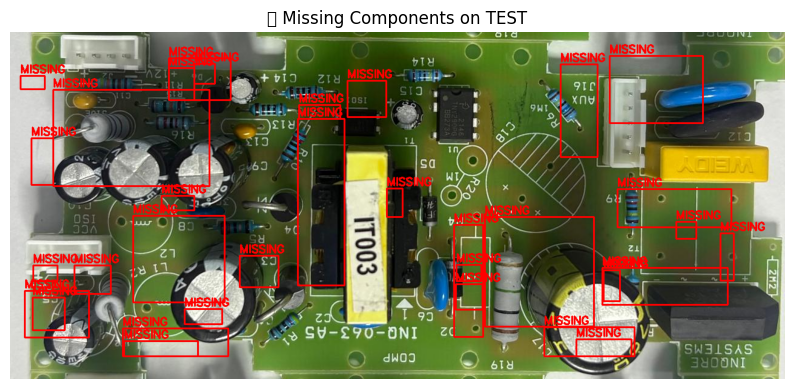


✅ Results saved to /content/pcb_output_final/pcb_comparison_results.json
{
    "master": 47,
    "test": 44,
    "missing": 33
}


In [14]:
# ==============================================================
# 🔁 SMART PCB DETECTION & COMPARISON PIPELINE
# YOLO → SAM → (FastSAM + HQ-SAM if available)
# Physical filters (size, color, texture, shape)
# ==============================================================
!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

import os, cv2, json, numpy as np, matplotlib.pyplot as plt, torch
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
from PIL import Image

# ---------------------------
# Optional FastSAM
# ---------------------------
use_fastsam = False
try:
    from fastsam import FastSAM, FastSAMPrompt
    use_fastsam = True
    print("✅ FastSAM available and will be used.")
except:
    print("⚠️ FastSAM not available — using YOLO + SAM only.")

# ---------------------------
# Paths and Config
# ---------------------------
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
OUT_DIR = "/content/pcb_output_final"
os.makedirs(OUT_DIR, exist_ok=True)

YOLO_PATH = "/content/best.pt"
MASTER_PATH = "/content/Masterrrrrr.jpeg"
TEST_PATH   = "/content/tesssttt.jpeg"
SAM_CKPT = "/content/sam_vit_b_01ec64.pth"

CONF_YOLO = 0.55
MIN_BOX_AREA = 800
MAX_BOX_AREA = 60000
MAX_ASPECT_RATIO = 5.0
MIN_ASPECT_RATIO = 0.2
GREEN_RANGE_LOW = np.array([25, 30, 30])
GREEN_RANGE_HIGH = np.array([100, 255, 255])
IOU_SIMILAR = 0.45
CENTER_THRESH = 40

# ---------------------------
# Helper Functions
# ---------------------------
def iou(a,b):
    xA,yA=max(a[0],b[0]),max(a[1],b[1])
    xB,yB=min(a[2],b[2]),min(a[3],b[3])
    inter=max(0,xB-xA)*max(0,yB-yA)
    areaA=(a[2]-a[0])*(a[3]-a[1])
    areaB=(b[2]-b[0])*(b[3]-b[1])
    return inter / (areaA + areaB - inter + 1e-9)

def box_center(box):
    x1,y1,x2,y2=box
    return ((x1+x2)/2, (y1+y2)/2)

def are_similar(boxA, boxB, iou_thresh=IOU_SIMILAR, center_thresh=CENTER_THRESH):
    if iou(boxA, boxB) >= iou_thresh: return True
    cA, cB = box_center(boxA), box_center(boxB)
    return np.linalg.norm(np.array(cA)-np.array(cB)) < center_thresh

def merge_boxes(boxes, iou_threshold=0.4):
    merged=[]
    for b in boxes:
        merged_flag=False
        for i,mb in enumerate(merged):
            if iou(b,mb)>iou_threshold:
                merged[i]=(min(b[0],mb[0]),min(b[1],mb[1]),max(b[2],mb[2]),max(b[3],mb[3]))
                merged_flag=True; break
        if not merged_flag: merged.append(b)
    return merged

def is_valid_component_physical(roi):
    """Rejects background regions using shape, color, and texture."""
    if roi is None or roi.size == 0: return False
    h,w = roi.shape[:2]; area=h*w
    aspect_ratio = w/h if h!=0 else 0
    if not (MIN_BOX_AREA < area < MAX_BOX_AREA): return False
    if not (MIN_ASPECT_RATIO <= aspect_ratio <= MAX_ASPECT_RATIO): return False

    hsv = cv2.cvtColor(roi, cv2.COLOR_BGR2HSV)
    green_mask = cv2.inRange(hsv, GREEN_RANGE_LOW, GREEN_RANGE_HIGH)
    green_ratio = np.sum(green_mask>0)/area
    if green_ratio > 0.6:  # mostly PCB surface
        return False

    gray = cv2.cvtColor(roi, cv2.COLOR_BGR2GRAY)
    var = np.var(gray); edges=cv2.Canny(gray,50,150)
    edge_density = np.sum(edges>0)/area
    if var < 80 or edge_density < 0.02:
        return False
    return True

def draw_boxes(image_rgb, boxes, color=(0,255,0), label=None):
    vis=image_rgb.copy()
    for (x1,y1,x2,y2) in boxes:
        cv2.rectangle(vis,(x1,y1),(x2,y2),color,2)
        if label: cv2.putText(vis,label,(x1,max(20,y1-5)),cv2.FONT_HERSHEY_SIMPLEX,0.6,color,2)
    return vis

# ---------------------------
# Load Models
# ---------------------------
if not os.path.exists(YOLO_PATH):
    raise FileNotFoundError(f"YOLO model missing: {YOLO_PATH}")
yolo = YOLO(YOLO_PATH)
print("✅ YOLO loaded.")

if not os.path.exists(SAM_CKPT):
    print("📥 Downloading SAM...")
    !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {SAM_CKPT}
sam = sam_model_registry["vit_b"](checkpoint=SAM_CKPT).to(DEVICE)
sam_mask_gen = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=32,
    pred_iou_thresh=0.9,
    stability_score_thresh=0.95,
    crop_n_layers=1,
    min_mask_region_area=1000
)
print("✅ SAM ready on", DEVICE)

# ---------------------------
# Detection Function
# ---------------------------
def detect_components(image_path, name="img"):
    print(f"\n🔹 Detecting {name}...")
    bgr = cv2.imread(image_path)
    rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
    h,w = rgb.shape[:2]
    detected=[]

    # Step 1: YOLO
    res = yolo(rgb, conf=CONF_YOLO, verbose=False)
    if len(res)>0:
        for b in res[0].boxes.xyxy.cpu().numpy():
            x1,y1,x2,y2=map(int,b[:4])
            if (x2-x1)*(y2-y1)>MIN_BOX_AREA:
                detected.append((x1,y1,x2,y2))
    detected=merge_boxes(detected)
    print(f"YOLO: {len(detected)}")

    # Step 2: SAM on uncovered area
    mask_yolo = np.zeros((h,w), dtype=np.uint8)
    for (x1,y1,x2,y2) in detected:
        cv2.rectangle(mask_yolo, (x1,y1), (x2,y2), 255, -1)
    inverse_mask = cv2.bitwise_not(mask_yolo)
    uncovered = cv2.bitwise_and(rgb,rgb,mask=inverse_mask)

    sam_boxes=[]
    try:
        masks=sam_mask_gen.generate(uncovered)
        for m in masks:
            seg=m["segmentation"].astype('uint8')
            x,y,ww,hh=cv2.boundingRect(seg)
            roi=bgr[y:y+hh,x:x+ww]
            if is_valid_component_physical(roi):
                sam_boxes.append((x,y,x+ww,y+hh))
    except Exception as e:
        print("SAM error:", e)
    sam_boxes=merge_boxes(sam_boxes)
    print(f"SAM: {len(sam_boxes)}")

    # Step 3: Combine
    final=merge_boxes(detected+sam_boxes)
    vis=draw_boxes(rgb,final,(0,255,0),label=name)
    cv2.imwrite(os.path.join(OUT_DIR,f"{name}_detections.png"),cv2.cvtColor(vis,cv2.COLOR_RGB2BGR))
    return final, rgb

# ---------------------------
# Run on Master and Test
# ---------------------------
master_boxes, master_rgb = detect_components(MASTER_PATH, "master")
test_boxes, test_rgb     = detect_components(TEST_PATH, "test")

# ---------------------------
# Compare and Mark Missing
# ---------------------------
missing=[]
for mb in master_boxes:
    if not any(are_similar(mb, tb) for tb in test_boxes):
        missing.append(mb)
missing=merge_boxes(missing)

# Draw missing on test
vis_test = draw_boxes(test_rgb, missing, color=(255,0,0), label="MISSING")
if not missing:
    cv2.putText(vis_test, "✅ GOOD BOARD - No Missing Components",
                (30,50), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0,200,0), 3)

cv2.imwrite(os.path.join(OUT_DIR,"test_missing.png"), cv2.cvtColor(vis_test, cv2.COLOR_RGB2BGR))

plt.figure(figsize=(10,10))
plt.imshow(vis_test)
plt.title("🔴 Missing Components on TEST")
plt.axis("off")
plt.show()

# ---------------------------
# Save Results to JSON
# ---------------------------
output_data = {
    "master_components": [{"x1":x1,"y1":y1,"x2":x2,"y2":y2} for (x1,y1,x2,y2) in master_boxes],
    "test_components": [{"x1":x1,"y1":y1,"x2":x2,"y2":y2} for (x1,y1,x2,y2) in test_boxes],
    "missing_components": [{"x1":x1,"y1":y1,"x2":x2,"y2":y2} for (x1,y1,x2,y2) in missing],
    "counts": {"master":len(master_boxes),"test":len(test_boxes),"missing":len(missing)}
}

output_path = os.path.join(OUT_DIR,"pcb_comparison_results.json")
with open(output_path,"w") as f: json.dump(output_data,f,indent=4)

print(f"\n✅ Results saved to {output_path}")
print(json.dumps(output_data["counts"], indent=4))


✅ YOLO loaded successfully.
✅ SAM ready on cuda
📸 Upload Master and Test PCB images:


Saving tesssttt.jpeg to tesssttt (7).jpeg
Saving Masterrrrrr.jpeg to Masterrrrrr (7).jpeg
✅ Master: tesssttt (7).jpeg, Test: Masterrrrrr (7).jpeg

🔹 Detecting master...
YOLO detected: 6 components
SAM added: 42 components

🔹 Detecting test...
YOLO detected: 5 components
SAM added: 46 components


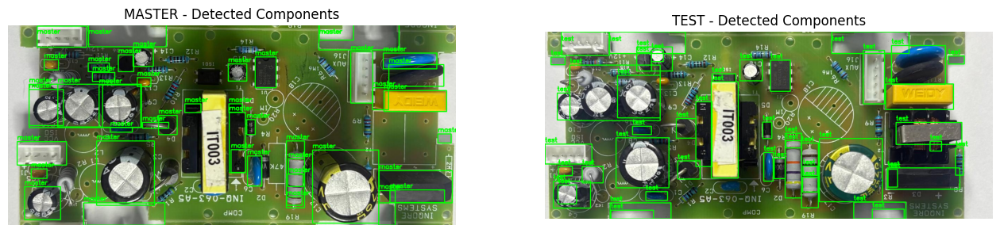

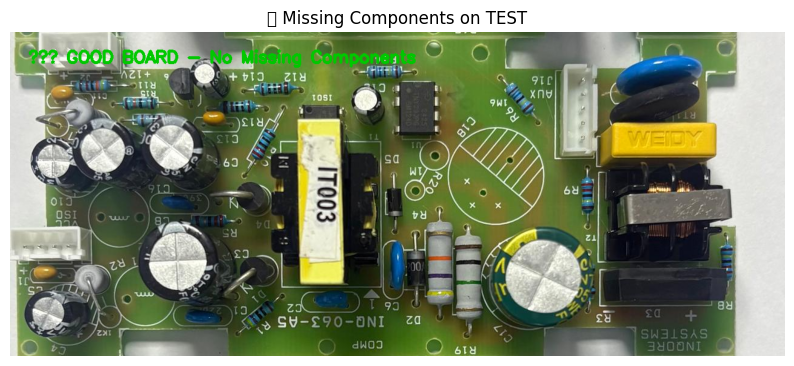


✅ JSON saved to /content/pcb_output_final/pcb_comparison_results.json
{
    "master": 44,
    "test": 47,
    "missing": 0
}


In [16]:
# ==============================================================
# 🔁 SMART PCB DETECTION & COMPARISON PIPELINE (Interactive Version)
# YOLO → SAM + Physical Filters + One-to-One Matching
# ==============================================================

!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

import os, cv2, json, numpy as np, matplotlib.pyplot as plt, torch
from google.colab import files
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator

# ==============================================================
# CONFIGURATION
# ==============================================================
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
OUT_DIR = "/content/pcb_output_final"
os.makedirs(OUT_DIR, exist_ok=True)

YOLO_PATH = "/content/best.pt"
SAM_CKPT  = "/content/sam_vit_b_01ec64.pth"

CONF_YOLO = 0.55
MIN_BOX_AREA = 800
MAX_BOX_AREA = 60000
MAX_ASPECT_RATIO = 5.0
MIN_ASPECT_RATIO = 0.2
GREEN_LOW  = np.array([25, 30, 30])
GREEN_HIGH = np.array([100, 255, 255])

# ==============================================================
# HELPER FUNCTIONS
# ==============================================================
def iou(a,b):
    xA,yA=max(a[0],b[0]),max(a[1],b[1])
    xB,yB=min(a[2],b[2]),min(a[3],b[3])
    inter=max(0,xB-xA)*max(0,yB-yA)
    areaA=(a[2]-a[0])*(a[3]-a[1])
    areaB=(b[2]-b[0])*(b[3]-b[1])
    return inter / (areaA + areaB - inter + 1e-9)

def box_center(box):
    x1,y1,x2,y2 = box
    return ((x1+x2)/2, (y1+y2)/2)

def merge_boxes(boxes, iou_threshold=0.4):
    merged = []
    for b in boxes:
        merged_flag=False
        for i,mb in enumerate(merged):
            if iou(b,mb)>iou_threshold:
                merged[i]=(min(b[0],mb[0]),min(b[1],mb[1]),max(b[2],mb[2]),max(b[3],mb[3]))
                merged_flag=True
                break
        if not merged_flag: merged.append(b)
    return merged

def are_really_similar(boxA, boxB, iou_thresh=0.3, center_thresh=60, size_thresh=0.4):
    """Checks if two boxes likely represent the same component."""
    if iou(boxA, boxB) >= iou_thresh:
        return True
    cA, cB = box_center(boxA), box_center(boxB)
    if np.linalg.norm(np.array(cA) - np.array(cB)) < center_thresh:
        return True
    wA, hA = boxA[2]-boxA[0], boxA[3]-boxA[1]
    wB, hB = boxB[2]-boxB[0], boxB[3]-boxB[1]
    size_ratio = min(wA, wB) / (max(wA, wB) + 1e-9)
    if size_ratio > (1 - size_thresh):
        return True
    return False

def find_missing_components(master_boxes, test_boxes):
    """One-to-one matching to prevent overcounting."""
    test_used = [False]*len(test_boxes)
    missing = []
    for mb in master_boxes:
        matched = False
        for i, tb in enumerate(test_boxes):
            if not test_used[i] and are_really_similar(mb, tb):
                test_used[i] = True
                matched = True
                break
        if not matched:
            missing.append(mb)
    return merge_boxes(missing)

def is_valid_component_physical(roi):
    """Rejects background using shape, color, and texture filters."""
    if roi is None or roi.size == 0: return False
    h,w = roi.shape[:2]; area = h*w
    aspect = w/h if h!=0 else 0
    if not (MIN_BOX_AREA < area < MAX_BOX_AREA): return False
    if not (MIN_ASPECT_RATIO <= aspect <= MAX_ASPECT_RATIO): return False

    hsv = cv2.cvtColor(roi, cv2.COLOR_BGR2HSV)
    green_mask = cv2.inRange(hsv, GREEN_LOW, GREEN_HIGH)
    green_ratio = np.sum(green_mask>0)/area
    if green_ratio > 0.6: return False

    gray = cv2.cvtColor(roi, cv2.COLOR_BGR2GRAY)
    var = np.var(gray)
    edges = cv2.Canny(gray, 50, 150)
    edge_density = np.sum(edges>0)/area
    if var < 80 or edge_density < 0.02:
        return False
    return True

def draw_boxes(image_rgb, boxes, color=(0,255,0), label=None):
    vis = image_rgb.copy()
    for (x1,y1,x2,y2) in boxes:
        cv2.rectangle(vis, (x1,y1), (x2,y2), color, 2)
        if label:
            cv2.putText(vis, label, (x1, max(25, y1-6)), cv2.FONT_HERSHEY_SIMPLEX, 0.6, color, 2)
    return vis

# ==============================================================
# MODEL LOADING
# ==============================================================
if not os.path.exists(YOLO_PATH):
    raise FileNotFoundError("❌ best.pt (YOLO model) not found!")

yolo = YOLO(YOLO_PATH)
print("✅ YOLO loaded successfully.")

if not os.path.exists(SAM_CKPT):
    print("📥 Downloading SAM (ViT-B)...")
    !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {SAM_CKPT}
sam = sam_model_registry["vit_b"](checkpoint=SAM_CKPT).to(DEVICE)
sam_mask_gen = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=32,
    pred_iou_thresh=0.9,
    stability_score_thresh=0.95,
    crop_n_layers=1,
    min_mask_region_area=1200
)
print("✅ SAM ready on", DEVICE)

# ==============================================================
# UPLOAD MASTER AND TEST IMAGES
# ==============================================================
print("📸 Upload Master and Test PCB images:")
uploaded = files.upload()
if len(uploaded) < 2:
    raise ValueError("Please upload both Master and Test images!")

MASTER_PATH, TEST_PATH = list(uploaded.keys())[:2]
print(f"✅ Master: {MASTER_PATH}, Test: {TEST_PATH}")

# ==============================================================
# COMPONENT DETECTION PIPELINE
# ==============================================================
def detect_components(image_path, name="img"):
    print(f"\n🔹 Detecting {name}...")
    bgr = cv2.imread(image_path)
    rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
    h,w = rgb.shape[:2]
    detected = []

    # ---- STEP 1: YOLO ----
    res = yolo(rgb, conf=CONF_YOLO, verbose=False)
    for b in res[0].boxes.xyxy.cpu().numpy():
        x1,y1,x2,y2 = map(int,b[:4])
        if (x2-x1)*(y2-y1) > MIN_BOX_AREA:
            detected.append((x1,y1,x2,y2))
    detected = merge_boxes(detected)
    print(f"YOLO detected: {len(detected)} components")

    # ---- STEP 2: SAM ----
    mask_yolo = np.zeros((h,w), dtype=np.uint8)
    for (x1,y1,x2,y2) in detected:
        cv2.rectangle(mask_yolo, (x1,y1), (x2,y2), 255, -1)
    inverse_mask = cv2.bitwise_not(mask_yolo)
    uncovered = cv2.bitwise_and(rgb, rgb, mask=inverse_mask)

    sam_boxes = []
    try:
        masks = sam_mask_gen.generate(uncovered)
        for m in masks:
            seg = m["segmentation"].astype('uint8')
            x,y,ww,hh = cv2.boundingRect(seg)
            roi = bgr[y:y+hh, x:x+ww]
            if is_valid_component_physical(roi):
                sam_boxes.append((x,y,x+ww,y+hh))
    except Exception as e:
        print("SAM error:", e)

    sam_boxes = merge_boxes(sam_boxes)
    print(f"SAM added: {len(sam_boxes)} components")

    final_boxes = merge_boxes(detected + sam_boxes)
    vis = draw_boxes(rgb, final_boxes, (0,255,0), name)
    cv2.imwrite(os.path.join(OUT_DIR, f"{name}_detections.png"), cv2.cvtColor(vis, cv2.COLOR_RGB2BGR))
    return final_boxes, rgb, vis

# ==============================================================
# RUN DETECTION + SHOW MASTER/TEST IMAGES
# ==============================================================
master_boxes, master_rgb, master_vis = detect_components(MASTER_PATH, "master")
test_boxes, test_rgb, test_vis = detect_components(TEST_PATH, "test")

# Show side-by-side comparison
fig, axs = plt.subplots(1, 2, figsize=(16, 8))
axs[0].imshow(master_vis); axs[0].set_title("MASTER - Detected Components"); axs[0].axis("off")
axs[1].imshow(test_vis); axs[1].set_title("TEST - Detected Components"); axs[1].axis("off")
plt.show()

# ==============================================================
# FIND AND VISUALIZE MISSING COMPONENTS
# ==============================================================
missing = find_missing_components(master_boxes, test_boxes)
vis_test = draw_boxes(test_rgb, missing, (255,0,0), "MISSING")

if not missing:
    cv2.putText(vis_test, "✅ GOOD BOARD - No Missing Components",
                (30,50), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0,200,0), 3)

cv2.imwrite(os.path.join(OUT_DIR, "test_missing.png"), cv2.cvtColor(vis_test, cv2.COLOR_RGB2BGR))
plt.figure(figsize=(10,10))
plt.imshow(vis_test)
plt.title("🔴 Missing Components on TEST")
plt.axis("off")
plt.show()

# ==============================================================
# SAVE JSON RESULTS
# ==============================================================
output_data = {
    "master_components": [{"x1":x1,"y1":y1,"x2":x2,"y2":y2} for (x1,y1,x2,y2) in master_boxes],
    "test_components": [{"x1":x1,"y1":y1,"x2":x2,"y2":y2} for (x1,y1,x2,y2) in test_boxes],
    "missing_components": [{"x1":x1,"y1":y1,"x2":x2,"y2":y2} for (x1,y1,x2,y2) in missing],
    "counts": {"master": len(master_boxes), "test": len(test_boxes), "missing": len(missing)}
}
output_path = os.path.join(OUT_DIR, "pcb_comparison_results.json")
with open(output_path, "w") as f:
    json.dump(output_data, f, indent=4)

print(f"\n✅ JSON saved to {output_path}")
print(json.dumps(output_data["counts"], indent=4))


✅ YOLO loaded successfully.
✅ SAM ready on cuda
📸 Upload the MASTER PCB image first:


Saving A.jpeg to A (2).jpeg
✅ Master image loaded: A (2).jpeg

📸 Now upload the TEST PCB image:


Saving B.jpeg to B (2).jpeg
✅ Test image loaded: B (2).jpeg

🔹 Detecting master...
YOLO detected: 0 components
SAM added: 13 components

🔹 Detecting test...
YOLO detected: 0 components
SAM added: 14 components


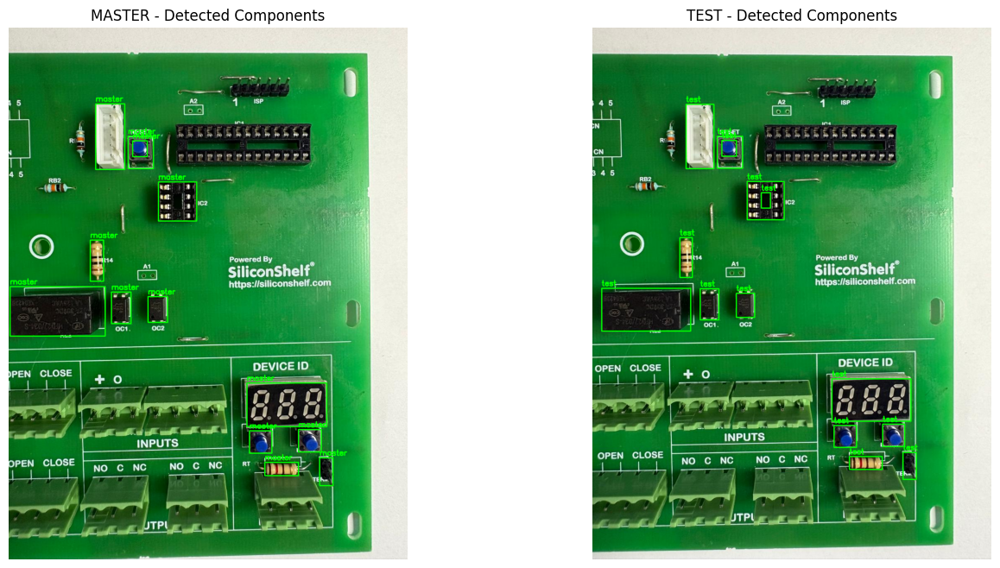

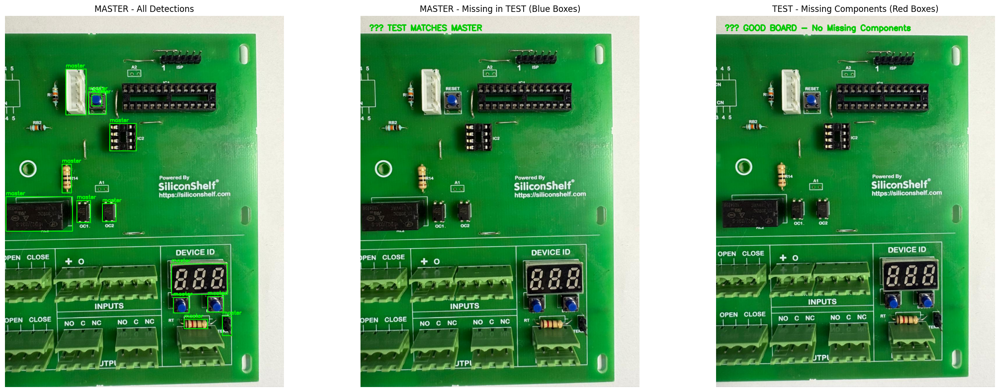


✅ JSON saved to /content/pcb_output_master_test/pcb_comparison_results.json
{
    "master": 13,
    "test": 14,
    "missing": 0
}


In [23]:
# ==============================================================
# 🔁 SMART PCB DETECTION & COMPARISON PIPELINE (Sequential Uploads)
# YOLO → SAM + Physical Filters + One-to-One Matching
# ==============================================================

!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

import os, cv2, json, numpy as np, matplotlib.pyplot as plt, torch
from google.colab import files
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator

# ==============================================================
# CONFIGURATION
# ==============================================================
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
OUT_DIR = "/content/pcb_output_master_test"
os.makedirs(OUT_DIR, exist_ok=True)

YOLO_PATH = "/content/best.pt"
SAM_CKPT  = "/content/sam_vit_b_01ec64.pth"

CONF_YOLO = 0.55
MIN_BOX_AREA = 800
MAX_BOX_AREA = 60000
MAX_ASPECT_RATIO = 5.0
MIN_ASPECT_RATIO = 0.2
GREEN_LOW  = np.array([25, 30, 30])
GREEN_HIGH = np.array([100, 255, 255])

# ==============================================================
# HELPER FUNCTIONS
# ==============================================================
def iou(a,b):
    xA,yA=max(a[0],b[0]),max(a[1],b[1])
    xB,yB=min(a[2],b[2]),min(a[3],b[3])
    inter=max(0,xB-xA)*max(0,yB-yA)
    areaA=(a[2]-a[0])*(a[3]-a[1])
    areaB=(b[2]-b[0])*(b[3]-b[1])
    return inter / (areaA + areaB - inter + 1e-9)

def box_center(box):
    x1,y1,x2,y2 = box
    return ((x1+x2)/2, (y1+y2)/2)

def merge_boxes(boxes, iou_threshold=0.4):
    merged = []
    for b in boxes:
        merged_flag=False
        for i,mb in enumerate(merged):
            if iou(b,mb)>iou_threshold:
                merged[i]=(min(b[0],mb[0]),min(b[1],mb[1]),max(b[2],mb[2]),max(b[3],mb[3]))
                merged_flag=True
                break
        if not merged_flag: merged.append(b)
    return merged

def are_really_similar(boxA, boxB, iou_thresh=0.3, center_thresh=60, size_thresh=0.4):
    """Checks if two boxes likely represent the same component."""
    if iou(boxA, boxB) >= iou_thresh:
        return True
    cA, cB = box_center(boxA), box_center(boxB)
    if np.linalg.norm(np.array(cA) - np.array(cB)) < center_thresh:
        return True
    wA, hA = boxA[2]-boxA[0], boxA[3]-boxA[1]
    wB, hB = boxB[2]-boxB[0], boxB[3]-boxB[1]
    size_ratio = min(wA, wB) / (max(wA, wB) + 1e-9)
    if size_ratio > (1 - size_thresh):
        return True
    return False

def find_missing_components(master_boxes, test_boxes):
    """One-to-one matching to prevent overcounting."""
    test_used = [False]*len(test_boxes)
    missing = []
    for mb in master_boxes:
        matched = False
        for i, tb in enumerate(test_boxes):
            if not test_used[i] and are_really_similar(mb, tb):
                test_used[i] = True
                matched = True
                break
        if not matched:
            missing.append(mb)
    return merge_boxes(missing)

def is_valid_component_physical(roi):
    """Rejects background using shape, color, and texture filters."""
    if roi is None or roi.size == 0: return False
    h,w = roi.shape[:2]; area = h*w
    aspect = w/h if h!=0 else 0
    if not (MIN_BOX_AREA < area < MAX_BOX_AREA): return False
    if not (MIN_ASPECT_RATIO <= aspect <= MAX_ASPECT_RATIO): return False

    hsv = cv2.cvtColor(roi, cv2.COLOR_BGR2HSV)
    green_mask = cv2.inRange(hsv, GREEN_LOW, GREEN_HIGH)
    green_ratio = np.sum(green_mask>0)/area
    if green_ratio > 0.6: return False

    gray = cv2.cvtColor(roi, cv2.COLOR_BGR2GRAY)
    var = np.var(gray)
    edges = cv2.Canny(gray, 50, 150)
    edge_density = np.sum(edges>0)/area
    if var < 80 or edge_density < 0.02:
        return False
    return True

def draw_boxes(image_rgb, boxes, color=(0,255,0), label=None):
    vis = image_rgb.copy()
    for (x1,y1,x2,y2) in boxes:
        cv2.rectangle(vis, (x1,y1), (x2,y2), color, 2)
        if label:
            cv2.putText(vis, label, (x1, max(25, y1-6)), cv2.FONT_HERSHEY_SIMPLEX, 0.6, color, 2)
    return vis

# ==============================================================
# MODEL LOADING
# ==============================================================
if not os.path.exists(YOLO_PATH):
    raise FileNotFoundError("❌ best.pt (YOLO model) not found!")

yolo = YOLO(YOLO_PATH)
print("✅ YOLO loaded successfully.")

if not os.path.exists(SAM_CKPT):
    print("📥 Downloading SAM (ViT-B)...")
    !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {SAM_CKPT}
sam = sam_model_registry["vit_b"](checkpoint=SAM_CKPT).to(DEVICE)
sam_mask_gen = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=32,
    pred_iou_thresh=0.9,
    stability_score_thresh=0.95,
    crop_n_layers=1,
    min_mask_region_area=1200
)
print("✅ SAM ready on", DEVICE)

# ==============================================================
# SEQUENTIAL IMAGE UPLOAD (Master first, then Test)
# ==============================================================
print("📸 Upload the MASTER PCB image first:")
master_upload = files.upload()
MASTER_PATH = list(master_upload.keys())[0]
print(f"✅ Master image loaded: {MASTER_PATH}")

print("\n📸 Now upload the TEST PCB image:")
test_upload = files.upload()
TEST_PATH = list(test_upload.keys())[0]
print(f"✅ Test image loaded: {TEST_PATH}")

# ==============================================================
# COMPONENT DETECTION PIPELINE
# ==============================================================
def detect_components(image_path, name="img"):
    print(f"\n🔹 Detecting {name}...")
    bgr = cv2.imread(image_path)
    rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
    h,w = rgb.shape[:2]
    detected = []

    # ---- STEP 1: YOLO ----
    res = yolo(rgb, conf=CONF_YOLO, verbose=False)
    for b in res[0].boxes.xyxy.cpu().numpy():
        x1,y1,x2,y2 = map(int,b[:4])
        if (x2-x1)*(y2-y1) > MIN_BOX_AREA:
            detected.append((x1,y1,x2,y2))
    detected = merge_boxes(detected)
    print(f"YOLO detected: {len(detected)} components")

    # ---- STEP 2: SAM ----
    mask_yolo = np.zeros((h,w), dtype=np.uint8)
    for (x1,y1,x2,y2) in detected:
        cv2.rectangle(mask_yolo, (x1,y1), (x2,y2), 255, -1)
    inverse_mask = cv2.bitwise_not(mask_yolo)
    uncovered = cv2.bitwise_and(rgb, rgb, mask=inverse_mask)

    sam_boxes = []
    try:
        masks = sam_mask_gen.generate(uncovered)
        for m in masks:
            seg = m["segmentation"].astype('uint8')
            x,y,ww,hh = cv2.boundingRect(seg)
            roi = bgr[y:y+hh, x:x+ww]
            if is_valid_component_physical(roi):
                sam_boxes.append((x,y,x+ww,y+hh))
    except Exception as e:
        print("SAM error:", e)

    sam_boxes = merge_boxes(sam_boxes)
    print(f"SAM added: {len(sam_boxes)} components")

    final_boxes = merge_boxes(detected + sam_boxes)
    vis = draw_boxes(rgb, final_boxes, (0,255,0), name)
    cv2.imwrite(os.path.join(OUT_DIR, f"{name}_detections.png"), cv2.cvtColor(vis, cv2.COLOR_RGB2BGR))
    return final_boxes, rgb, vis

# ==============================================================
# RUN DETECTION + SHOW MASTER/TEST IMAGES
# ==============================================================
master_boxes, master_rgb, master_vis = detect_components(MASTER_PATH, "master")
test_boxes, test_rgb, test_vis = detect_components(TEST_PATH, "test")

# Show side-by-side comparison
fig, axs = plt.subplots(1, 2, figsize=(16, 8))
axs[0].imshow(master_vis); axs[0].set_title("MASTER - Detected Components"); axs[0].axis("off")
axs[1].imshow(test_vis); axs[1].set_title("TEST - Detected Components"); axs[1].axis("off")
plt.show()

# ==============================================================
# FIND AND VISUALIZE MISSING COMPONENTS
# ==============================================================
missing = find_missing_components(master_boxes, test_boxes)

# 🔴 Draw missing boxes on Test (where components are absent)
vis_test = draw_boxes(test_rgb, missing, (255, 0, 0), "MISSING")

# 🔵 Draw missing boxes on Master (where components exist)
vis_master = draw_boxes(master_rgb, missing, (0, 128, 255), "MISSING_IN_TEST")

if not missing:
    cv2.putText(vis_test, "✅ GOOD BOARD - No Missing Components",
                (30,50), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0,200,0), 3)
    cv2.putText(vis_master, "✅ TEST MATCHES MASTER",
                (30,50), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0,200,0), 3)

cv2.imwrite(os.path.join(OUT_DIR, "test_missing.png"), cv2.cvtColor(vis_test, cv2.COLOR_RGB2BGR))
cv2.imwrite(os.path.join(OUT_DIR, "master_missing.png"), cv2.cvtColor(vis_master, cv2.COLOR_RGB2BGR))

# ==============================================================
# DISPLAY FINAL RESULTS
# ==============================================================
fig, axs = plt.subplots(1, 3, figsize=(22, 8))
axs[0].imshow(master_vis); axs[0].set_title("MASTER - All Detections"); axs[0].axis("off")
axs[1].imshow(vis_master); axs[1].set_title("MASTER - Missing in TEST (Blue Boxes)"); axs[1].axis("off")
axs[2].imshow(vis_test); axs[2].set_title("TEST - Missing Components (Red Boxes)"); axs[2].axis("off")
plt.tight_layout()
plt.show()

# ==============================================================
# SAVE JSON RESULTS
# ==============================================================
output_data = {
    "master_components": [{"x1":x1,"y1":y1,"x2":x2,"y2":y2} for (x1,y1,x2,y2) in master_boxes],
    "test_components": [{"x1":x1,"y1":y1,"x2":x2,"y2":y2} for (x1,y1,x2,y2) in test_boxes],
    "missing_components": [{"x1":x1,"y1":y1,"x2":x2,"y2":y2} for (x1,y1,x2,y2) in missing],
    "counts": {"master": len(master_boxes), "test": len(test_boxes), "missing": len(missing)}
}
output_path = os.path.join(OUT_DIR, "pcb_comparison_results.json")
with open(output_path, "w") as f:
    json.dump(output_data, f, indent=4)

print(f"\n✅ JSON saved to {output_path}")
print(json.dumps(output_data["counts"], indent=4))


✅ YOLO loaded successfully.
✅ SAM ready on cuda
📸 Upload the MASTER PCB image first:


Saving Masterrrrrr.jpeg to Masterrrrrr (14).jpeg
✅ Master image loaded: Masterrrrrr (14).jpeg

📸 Now upload the TEST PCB image:


Saving tesssttt.jpeg to tesssttt (14).jpeg
✅ Test image loaded: tesssttt (14).jpeg

🔹 Detecting master...
YOLO detected: 5 components
SAM added: 46 components

🔹 Detecting test...
YOLO detected: 6 components
SAM added: 42 components


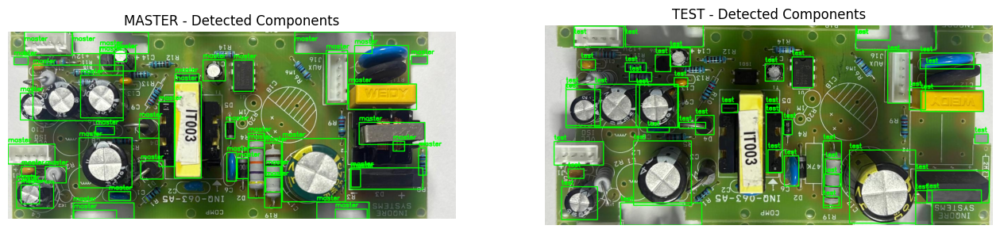

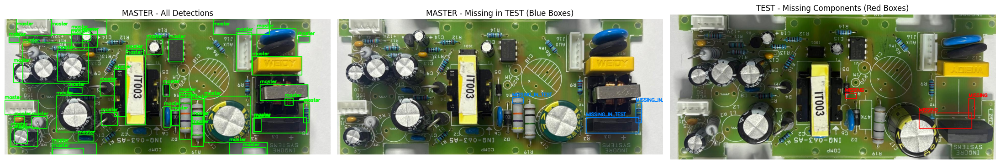


✅ JSON saved to /content/pcb_output_master_test/pcb_comparison_results.json
{
    "master": 47,
    "test": 44,
    "missing": 3
}


In [24]:
# ==============================================================
# 🔁 SMART PCB DETECTION & COMPARISON PIPELINE (Sequential Uploads)
# YOLO → SAM + Physical Filters + One-to-One Matching
# ==============================================================

!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

import os, cv2, json, numpy as np, matplotlib.pyplot as plt, torch
from google.colab import files
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator

# ==============================================================
# CONFIGURATION
# ==============================================================
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
OUT_DIR = "/content/pcb_output_master_test"
os.makedirs(OUT_DIR, exist_ok=True)

YOLO_PATH = "/content/best.pt"
SAM_CKPT  = "/content/sam_vit_b_01ec64.pth"

CONF_YOLO = 0.55
MIN_BOX_AREA = 800
MAX_BOX_AREA = 60000
MAX_ASPECT_RATIO = 5.0
MIN_ASPECT_RATIO = 0.2
GREEN_LOW  = np.array([25, 30, 30])
GREEN_HIGH = np.array([100, 255, 255])

# ==============================================================
# HELPER FUNCTIONS
# ==============================================================
def iou(a,b):
    xA,yA=max(a[0],b[0]),max(a[1],b[1])
    xB,yB=min(a[2],b[2]),min(a[3],b[3])
    inter=max(0,xB-xA)*max(0,yB-yA)
    areaA=(a[2]-a[0])*(a[3]-a[1])
    areaB=(b[2]-b[0])*(b[3]-b[1])
    return inter / (areaA + areaB - inter + 1e-9)

def box_center(box):
    x1,y1,x2,y2 = box
    return ((x1+x2)/2, (y1+y2)/2)

def merge_boxes(boxes, iou_threshold=0.4):
    merged = []
    for b in boxes:
        merged_flag=False
        for i,mb in enumerate(merged):
            if iou(b,mb)>iou_threshold:
                merged[i]=(min(b[0],mb[0]),min(b[1],mb[1]),max(b[2],mb[2]),max(b[3],mb[3]))
                merged_flag=True
                break
        if not merged_flag: merged.append(b)
    return merged

def are_really_similar(boxA, boxB, iou_thresh=0.3, center_thresh=60, size_thresh=0.4):
    """Checks if two boxes likely represent the same component."""
    if iou(boxA, boxB) >= iou_thresh:
        return True
    cA, cB = box_center(boxA), box_center(boxB)
    if np.linalg.norm(np.array(cA) - np.array(cB)) < center_thresh:
        return True
    wA, hA = boxA[2]-boxA[0], boxA[3]-boxA[1]
    wB, hB = boxB[2]-boxB[0], boxB[3]-boxB[1]
    size_ratio = min(wA, wB) / (max(wA, wB) + 1e-9)
    if size_ratio > (1 - size_thresh):
        return True
    return False

def find_missing_components(master_boxes, test_boxes):
    """One-to-one matching to prevent overcounting."""
    test_used = [False]*len(test_boxes)
    missing = []
    for mb in master_boxes:
        matched = False
        for i, tb in enumerate(test_boxes):
            if not test_used[i] and are_really_similar(mb, tb):
                test_used[i] = True
                matched = True
                break
        if not matched:
            missing.append(mb)
    return merge_boxes(missing)

def is_valid_component_physical(roi):
    """Rejects background using shape, color, and texture filters."""
    if roi is None or roi.size == 0: return False
    h,w = roi.shape[:2]; area = h*w
    aspect = w/h if h!=0 else 0
    if not (MIN_BOX_AREA < area < MAX_BOX_AREA): return False
    if not (MIN_ASPECT_RATIO <= aspect <= MAX_ASPECT_RATIO): return False

    hsv = cv2.cvtColor(roi, cv2.COLOR_BGR2HSV)
    green_mask = cv2.inRange(hsv, GREEN_LOW, GREEN_HIGH)
    green_ratio = np.sum(green_mask>0)/area
    if green_ratio > 0.6: return False

    gray = cv2.cvtColor(roi, cv2.COLOR_BGR2GRAY)
    var = np.var(gray)
    edges = cv2.Canny(gray, 50, 150)
    edge_density = np.sum(edges>0)/area
    if var < 80 or edge_density < 0.02:
        return False
    return True

def draw_boxes(image_rgb, boxes, color=(0,255,0), label=None):
    vis = image_rgb.copy()
    for (x1,y1,x2,y2) in boxes:
        cv2.rectangle(vis, (x1,y1), (x2,y2), color, 2)
        if label:
            cv2.putText(vis, label, (x1, max(25, y1-6)), cv2.FONT_HERSHEY_SIMPLEX, 0.6, color, 2)
    return vis

# ==============================================================
# MODEL LOADING
# ==============================================================
if not os.path.exists(YOLO_PATH):
    raise FileNotFoundError("❌ best.pt (YOLO model) not found!")

yolo = YOLO(YOLO_PATH)
print("✅ YOLO loaded successfully.")

if not os.path.exists(SAM_CKPT):
    print("📥 Downloading SAM (ViT-B)...")
    !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {SAM_CKPT}
sam = sam_model_registry["vit_b"](checkpoint=SAM_CKPT).to(DEVICE)
sam_mask_gen = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=32,
    pred_iou_thresh=0.9,
    stability_score_thresh=0.95,
    crop_n_layers=1,
    min_mask_region_area=1200
)
print("✅ SAM ready on", DEVICE)

# ==============================================================
# SEQUENTIAL IMAGE UPLOAD (Master first, then Test)
# ==============================================================
print("📸 Upload the MASTER PCB image first:")
master_upload = files.upload()
MASTER_PATH = list(master_upload.keys())[0]
print(f"✅ Master image loaded: {MASTER_PATH}")

print("\n📸 Now upload the TEST PCB image:")
test_upload = files.upload()
TEST_PATH = list(test_upload.keys())[0]
print(f"✅ Test image loaded: {TEST_PATH}")

# ==============================================================
# COMPONENT DETECTION PIPELINE
# ==============================================================
def detect_components(image_path, name="img"):
    print(f"\n🔹 Detecting {name}...")
    bgr = cv2.imread(image_path)
    rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
    h,w = rgb.shape[:2]
    detected = []

    # ---- STEP 1: YOLO ----
    res = yolo(rgb, conf=CONF_YOLO, verbose=False)
    for b in res[0].boxes.xyxy.cpu().numpy():
        x1,y1,x2,y2 = map(int,b[:4])
        if (x2-x1)*(y2-y1) > MIN_BOX_AREA:
            detected.append((x1,y1,x2,y2))
    detected = merge_boxes(detected)
    print(f"YOLO detected: {len(detected)} components")

    # ---- STEP 2: SAM ----
    mask_yolo = np.zeros((h,w), dtype=np.uint8)
    for (x1,y1,x2,y2) in detected:
        cv2.rectangle(mask_yolo, (x1,y1), (x2,y2), 255, -1)
    inverse_mask = cv2.bitwise_not(mask_yolo)
    uncovered = cv2.bitwise_and(rgb, rgb, mask=inverse_mask)

    sam_boxes = []
    try:
        masks = sam_mask_gen.generate(uncovered)
        for m in masks:
            seg = m["segmentation"].astype('uint8')
            x,y,ww,hh = cv2.boundingRect(seg)
            roi = bgr[y:y+hh, x:x+ww]
            if is_valid_component_physical(roi):
                sam_boxes.append((x,y,x+ww,y+hh))
    except Exception as e:
        print("SAM error:", e)

    sam_boxes = merge_boxes(sam_boxes)
    print(f"SAM added: {len(sam_boxes)} components")

    final_boxes = merge_boxes(detected + sam_boxes)
    vis = draw_boxes(rgb, final_boxes, (0,255,0), name)
    cv2.imwrite(os.path.join(OUT_DIR, f"{name}_detections.png"), cv2.cvtColor(vis, cv2.COLOR_RGB2BGR))
    return final_boxes, rgb, vis

# ==============================================================
# RUN DETECTION + SHOW MASTER/TEST IMAGES
# ==============================================================
master_boxes, master_rgb, master_vis = detect_components(MASTER_PATH, "master")
test_boxes, test_rgb, test_vis = detect_components(TEST_PATH, "test")

# Show side-by-side comparison
fig, axs = plt.subplots(1, 2, figsize=(16, 8))
axs[0].imshow(master_vis); axs[0].set_title("MASTER - Detected Components"); axs[0].axis("off")
axs[1].imshow(test_vis); axs[1].set_title("TEST - Detected Components"); axs[1].axis("off")
plt.show()

# ==============================================================
# FIND AND VISUALIZE MISSING COMPONENTS
# ==============================================================
missing = find_missing_components(master_boxes, test_boxes)

# 🔴 Draw missing boxes on Test (where components are absent)
vis_test = draw_boxes(test_rgb, missing, (255, 0, 0), "MISSING")

# 🔵 Draw missing boxes on Master (where components exist)
vis_master = draw_boxes(master_rgb, missing, (0, 128, 255), "MISSING_IN_TEST")

if not missing:
    cv2.putText(vis_test, "✅ GOOD BOARD - No Missing Components",
                (30,50), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0,200,0), 3)
    cv2.putText(vis_master, "✅ TEST MATCHES MASTER",
                (30,50), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0,200,0), 3)

cv2.imwrite(os.path.join(OUT_DIR, "test_missing.png"), cv2.cvtColor(vis_test, cv2.COLOR_RGB2BGR))
cv2.imwrite(os.path.join(OUT_DIR, "master_missing.png"), cv2.cvtColor(vis_master, cv2.COLOR_RGB2BGR))

# ==============================================================
# DISPLAY FINAL RESULTS
# ==============================================================
fig, axs = plt.subplots(1, 3, figsize=(22, 8))
axs[0].imshow(master_vis); axs[0].set_title("MASTER - All Detections"); axs[0].axis("off")
axs[1].imshow(vis_master); axs[1].set_title("MASTER - Missing in TEST (Blue Boxes)"); axs[1].axis("off")
axs[2].imshow(vis_test); axs[2].set_title("TEST - Missing Components (Red Boxes)"); axs[2].axis("off")
plt.tight_layout()
plt.show()

# ==============================================================
# SAVE JSON RESULTS
# ==============================================================
output_data = {
    "master_components": [{"x1":x1,"y1":y1,"x2":x2,"y2":y2} for (x1,y1,x2,y2) in master_boxes],
    "test_components": [{"x1":x1,"y1":y1,"x2":x2,"y2":y2} for (x1,y1,x2,y2) in test_boxes],
    "missing_components": [{"x1":x1,"y1":y1,"x2":x2,"y2":y2} for (x1,y1,x2,y2) in missing],
    "counts": {"master": len(master_boxes), "test": len(test_boxes), "missing": len(missing)}
}
output_path = os.path.join(OUT_DIR, "pcb_comparison_results.json")
with open(output_path, "w") as f:
    json.dump(output_data, f, indent=4)

print(f"\n✅ JSON saved to {output_path}")
print(json.dumps(output_data["counts"], indent=4))


✅ YOLO loaded successfully.
✅ SAM ready on cuda
📸 Upload the MASTER PCB image first:


Saving M1.jpeg to M1.jpeg
✅ Master image loaded: M1.jpeg

📸 Now upload the TEST PCB image:


Saving M2.jpeg to M2.jpeg
✅ Test image loaded: M2.jpeg

🔹 Detecting master...
YOLO detected: 1 components
SAM added: 24 components

🔹 Detecting test...
YOLO detected: 0 components
SAM added: 33 components


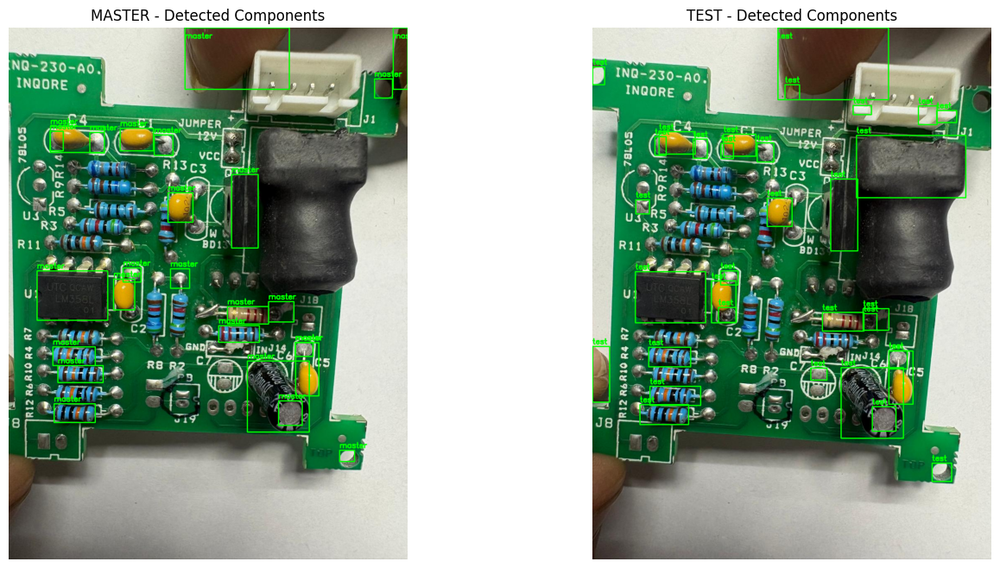

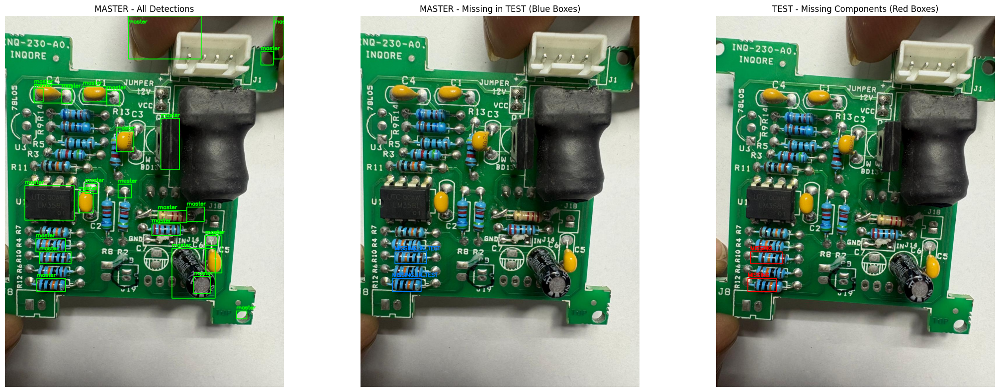


✅ JSON saved to /content/pcb_output_master_test/pcb_comparison_results.json
{
    "master": 25,
    "test": 33,
    "missing": 2
}


In [26]:
# ==============================================================
# 🔁 SMART PCB DETECTION & COMPARISON PIPELINE (Sequential Uploads)
# YOLO → SAM + Physical Filters + One-to-One Matching
# ==============================================================

!pip install -q ultralytics opencv-python Pillow matplotlib numpy torch torchvision segment-anything

import os, cv2, json, numpy as np, matplotlib.pyplot as plt, torch
from google.colab import files
from ultralytics import YOLO
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator

# ==============================================================
# CONFIGURATION
# ==============================================================
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
OUT_DIR = "/content/pcb_output_master_test"
os.makedirs(OUT_DIR, exist_ok=True)

YOLO_PATH = "/content/best.pt"
SAM_CKPT  = "/content/sam_vit_b_01ec64.pth"

CONF_YOLO = 0.55
MIN_BOX_AREA = 800
MAX_BOX_AREA = 60000
MAX_ASPECT_RATIO = 5.0
MIN_ASPECT_RATIO = 0.2
GREEN_LOW  = np.array([25, 30, 30])
GREEN_HIGH = np.array([100, 255, 255])

# ==============================================================
# HELPER FUNCTIONS
# ==============================================================
def iou(a,b):
    xA,yA=max(a[0],b[0]),max(a[1],b[1])
    xB,yB=min(a[2],b[2]),min(a[3],b[3])
    inter=max(0,xB-xA)*max(0,yB-yA)
    areaA=(a[2]-a[0])*(a[3]-a[1])
    areaB=(b[2]-b[0])*(b[3]-b[1])
    return inter / (areaA + areaB - inter + 1e-9)

def box_center(box):
    x1,y1,x2,y2 = box
    return ((x1+x2)/2, (y1+y2)/2)

def merge_boxes(boxes, iou_threshold=0.4):
    merged = []
    for b in boxes:
        merged_flag=False
        for i,mb in enumerate(merged):
            if iou(b,mb)>iou_threshold:
                merged[i]=(min(b[0],mb[0]),min(b[1],mb[1]),max(b[2],mb[2]),max(b[3],mb[3]))
                merged_flag=True
                break
        if not merged_flag: merged.append(b)
    return merged

def are_really_similar(boxA, boxB, iou_thresh=0.3, center_thresh=60, size_thresh=0.4):
    """Checks if two boxes likely represent the same component."""
    if iou(boxA, boxB) >= iou_thresh:
        return True
    cA, cB = box_center(boxA), box_center(boxB)
    if np.linalg.norm(np.array(cA) - np.array(cB)) < center_thresh:
        return True
    wA, hA = boxA[2]-boxA[0], boxA[3]-boxA[1]
    wB, hB = boxB[2]-boxB[0], boxB[3]-boxB[1]
    size_ratio = min(wA, wB) / (max(wA, wB) + 1e-9)
    if size_ratio > (1 - size_thresh):
        return True
    return False

def find_missing_components(master_boxes, test_boxes):
    """One-to-one matching to prevent overcounting."""
    test_used = [False]*len(test_boxes)
    missing = []
    for mb in master_boxes:
        matched = False
        for i, tb in enumerate(test_boxes):
            if not test_used[i] and are_really_similar(mb, tb):
                test_used[i] = True
                matched = True
                break
        if not matched:
            missing.append(mb)
    return merge_boxes(missing)

def is_valid_component_physical(roi):
    """Rejects background using shape, color, and texture filters."""
    if roi is None or roi.size == 0: return False
    h,w = roi.shape[:2]; area = h*w
    aspect = w/h if h!=0 else 0
    if not (MIN_BOX_AREA < area < MAX_BOX_AREA): return False
    if not (MIN_ASPECT_RATIO <= aspect <= MAX_ASPECT_RATIO): return False

    hsv = cv2.cvtColor(roi, cv2.COLOR_BGR2HSV)
    green_mask = cv2.inRange(hsv, GREEN_LOW, GREEN_HIGH)
    green_ratio = np.sum(green_mask>0)/area
    if green_ratio > 0.6: return False

    gray = cv2.cvtColor(roi, cv2.COLOR_BGR2GRAY)
    var = np.var(gray)
    edges = cv2.Canny(gray, 50, 150)
    edge_density = np.sum(edges>0)/area
    if var < 80 or edge_density < 0.02:
        return False
    return True

def draw_boxes(image_rgb, boxes, color=(0,255,0), label=None):
    vis = image_rgb.copy()
    for (x1,y1,x2,y2) in boxes:
        cv2.rectangle(vis, (x1,y1), (x2,y2), color, 2)
        if label:
            cv2.putText(vis, label, (x1, max(25, y1-6)), cv2.FONT_HERSHEY_SIMPLEX, 0.6, color, 2)
    return vis

# ==============================================================
# MODEL LOADING
# ==============================================================
if not os.path.exists(YOLO_PATH):
    raise FileNotFoundError("❌ best.pt (YOLO model) not found!")

yolo = YOLO(YOLO_PATH)
print("✅ YOLO loaded successfully.")

if not os.path.exists(SAM_CKPT):
    print("📥 Downloading SAM (ViT-B)...")
    !wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -O {SAM_CKPT}
sam = sam_model_registry["vit_b"](checkpoint=SAM_CKPT).to(DEVICE)
sam_mask_gen = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=32,
    pred_iou_thresh=0.9,
    stability_score_thresh=0.95,
    crop_n_layers=1,
    min_mask_region_area=1200
)
print("✅ SAM ready on", DEVICE)

# ==============================================================
# SEQUENTIAL IMAGE UPLOAD (Master first, then Test)
# ==============================================================
print("📸 Upload the MASTER PCB image first:")
master_upload = files.upload()
MASTER_PATH = list(master_upload.keys())[0]
print(f"✅ Master image loaded: {MASTER_PATH}")

print("\n📸 Now upload the TEST PCB image:")
test_upload = files.upload()
TEST_PATH = list(test_upload.keys())[0]
print(f"✅ Test image loaded: {TEST_PATH}")

# ==============================================================
# COMPONENT DETECTION PIPELINE
# ==============================================================
def detect_components(image_path, name="img"):
    print(f"\n🔹 Detecting {name}...")
    bgr = cv2.imread(image_path)
    rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
    h,w = rgb.shape[:2]
    detected = []

    # ---- STEP 1: YOLO ----
    res = yolo(rgb, conf=CONF_YOLO, verbose=False)
    for b in res[0].boxes.xyxy.cpu().numpy():
        x1,y1,x2,y2 = map(int,b[:4])
        if (x2-x1)*(y2-y1) > MIN_BOX_AREA:
            detected.append((x1,y1,x2,y2))
    detected = merge_boxes(detected)
    print(f"YOLO detected: {len(detected)} components")

    # ---- STEP 2: SAM ----
    mask_yolo = np.zeros((h,w), dtype=np.uint8)
    for (x1,y1,x2,y2) in detected:
        cv2.rectangle(mask_yolo, (x1,y1), (x2,y2), 255, -1)
    inverse_mask = cv2.bitwise_not(mask_yolo)
    uncovered = cv2.bitwise_and(rgb, rgb, mask=inverse_mask)

    sam_boxes = []
    try:
        masks = sam_mask_gen.generate(uncovered)
        for m in masks:
            seg = m["segmentation"].astype('uint8')
            x,y,ww,hh = cv2.boundingRect(seg)
            roi = bgr[y:y+hh, x:x+ww]
            if is_valid_component_physical(roi):
                sam_boxes.append((x,y,x+ww,y+hh))
    except Exception as e:
        print("SAM error:", e)

    sam_boxes = merge_boxes(sam_boxes)
    print(f"SAM added: {len(sam_boxes)} components")

    final_boxes = merge_boxes(detected + sam_boxes)
    vis = draw_boxes(rgb, final_boxes, (0,255,0), name)
    cv2.imwrite(os.path.join(OUT_DIR, f"{name}_detections.png"), cv2.cvtColor(vis, cv2.COLOR_RGB2BGR))
    return final_boxes, rgb, vis

# ==============================================================
# RUN DETECTION + SHOW MASTER/TEST IMAGES
# ==============================================================
master_boxes, master_rgb, master_vis = detect_components(MASTER_PATH, "master")
test_boxes, test_rgb, test_vis = detect_components(TEST_PATH, "test")

# Show side-by-side comparison
fig, axs = plt.subplots(1, 2, figsize=(16, 8))
axs[0].imshow(master_vis); axs[0].set_title("MASTER - Detected Components"); axs[0].axis("off")
axs[1].imshow(test_vis); axs[1].set_title("TEST - Detected Components"); axs[1].axis("off")
plt.show()

# ==============================================================
# FIND AND VISUALIZE MISSING COMPONENTS
# ==============================================================
missing = find_missing_components(master_boxes, test_boxes)

# 🔴 Draw missing boxes on Test (where components are absent)
vis_test = draw_boxes(test_rgb, missing, (255, 0, 0), "MISSING")

# 🔵 Draw missing boxes on Master (where components exist)
vis_master = draw_boxes(master_rgb, missing, (0, 128, 255), "MISSING_IN_TEST")

if not missing:
    cv2.putText(vis_test, "✅ GOOD BOARD - No Missing Components",
                (30,50), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0,200,0), 3)
    cv2.putText(vis_master, "✅ TEST MATCHES MASTER",
                (30,50), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0,200,0), 3)

cv2.imwrite(os.path.join(OUT_DIR, "test_missing.png"), cv2.cvtColor(vis_test, cv2.COLOR_RGB2BGR))
cv2.imwrite(os.path.join(OUT_DIR, "master_missing.png"), cv2.cvtColor(vis_master, cv2.COLOR_RGB2BGR))

# ==============================================================
# DISPLAY FINAL RESULTS
# ==============================================================
fig, axs = plt.subplots(1, 3, figsize=(22, 8))
axs[0].imshow(master_vis); axs[0].set_title("MASTER - All Detections"); axs[0].axis("off")
axs[1].imshow(vis_master); axs[1].set_title("MASTER - Missing in TEST (Blue Boxes)"); axs[1].axis("off")
axs[2].imshow(vis_test); axs[2].set_title("TEST - Missing Components (Red Boxes)"); axs[2].axis("off")
plt.tight_layout()
plt.show()

# ==============================================================
# SAVE JSON RESULTS
# ==============================================================
output_data = {
    "master_components": [{"x1":x1,"y1":y1,"x2":x2,"y2":y2} for (x1,y1,x2,y2) in master_boxes],
    "test_components": [{"x1":x1,"y1":y1,"x2":x2,"y2":y2} for (x1,y1,x2,y2) in test_boxes],
    "missing_components": [{"x1":x1,"y1":y1,"x2":x2,"y2":y2} for (x1,y1,x2,y2) in missing],
    "counts": {"master": len(master_boxes), "test": len(test_boxes), "missing": len(missing)}
}
output_path = os.path.join(OUT_DIR, "pcb_comparison_results.json")
with open(output_path, "w") as f:
    json.dump(output_data, f, indent=4)

print(f"\n✅ JSON saved to {output_path}")
print(json.dumps(output_data["counts"], indent=4))
